<head><p><img alt="udeA logo" height="150px" src="https://github.com/freddyduitama/images/blob/master/logo.png?raw=true" align="left" hspace="50px" vspace="0px" style="width:107px;height:152px;"></p>
<h1><font color='black'> <center>
       Bioseñales y Sistemas </center></font></h1>
<p3><center><b><font color='black' face="Lucida Calligraphy,Comic Sans MS,Lucida Console" size="5">Universidad de Antioquia</font></b> </center></p3>
</font>
<h2><font color='black'> <center>
Proyecto 4 - Machine Learning  </center></font></h2>
<h3><font color='black'> <center>
Danna Isabella Garcia Saenz - Solanlly Evenedy Montoya Rivera </center></font></h3>
<font  face="Courier New" size="3">
<p1><center> </center></p1></head>

*Teniendo en cuenta el proceso que hemos ido realizando en el curso atraves de los seguimiento, tenemos algunos parametros y metricas que ya conocemos para el manejo de estos datos, por lo tanto primero vamos a recordar las lineas de codigo que son importantes para el procesamiento de las señales.*


*Primero debemos importat las librerías necesarias para el procesamiento de datos, análisis y visualización, debemos de subir el Google Drive para acceder a los datos del proyecto, y asi mismo obtenemos la lista de directorios (sujetos) en la carpeta principal de datos y creamos una lista con las rutas completas de los directorios de cada sujeto. Despues de esto debemos recordar como se normalizan los datos en este caso los archivos de texto que comienzan con "2" (por ejemplo, "2_raw_data_12-12_25.04.16.txt") para cada sujeto. En el anterior seguimiento definimos unas funciones llamadas `plot_emg_and_tkeo_by_class` que leen los datos del archivo, normalizan los datos y calcula el TKEO (Teager-Kaiser Energy Operator) y grafica tanto la señal original como el TKEO para cada canal y cada clase, este codigo nos sirve para ir pre procesando los datos que vamos a utilizar y preparar el entorno del modelo.*

In [ ]:
from scipy.io import loadmat
import scipy.io as sio
import matplotlib.pyplot as plt
import numpy as np
from csv import reader as reader_csv;
import scipy.signal as signal;
import pandas as pd
import glob
import math
import os
from scipy.stats import linregress
from scipy.signal import find_peaks
from scipy.stats import kstest
from scipy.stats import levene
from scipy.stats import mannwhitneyu
import seaborn as sns
from scipy.signal import butter, filtfilt

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
carpeta_principal= "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master" #direccion de la ruta de la carpeta principal de datos
directorios= [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))] #obtenemos la lista de directorios en la carpeta

listas_sujetos= [] #creamos una lista con los sujetos
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto= os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

for i, lista in enumerate(listas_sujetos, 1):
    print(f"sujeto{i}: {lista}")

sujeto1: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/01
sujeto2: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/02
sujeto3: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/03
sujeto4: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/04
sujeto5: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/05
sujeto6: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/06
sujeto7: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/07
sujeto8: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/08
sujeto9: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/09
sujeto10: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/10
sujeto11: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/11
sujeto12: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_

In [ ]:
#para normalizar los datos de los archivos

for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt= glob.glob(os.path.join(lista, "2*.txt"))

    for archivo in archivos_txt:
        datos= []
        with open(archivo, 'r') as file:
            next(file)  #saltamos la primera fila para evitar errores por los titulos
            for linea in file:
                valores= [float(valor) for valor in linea.strip().split('\t')[1:9]]  #valores de los canales 1 a 8
                datos.append(valores)
        datos_transpuestos= np.array(list(zip(*datos)))  #transposicion de los datos

        for canal, valores_canal in enumerate(datos_transpuestos, 1):
            valores_canal= (valores_canal - np.mean(valores_canal)) / np.std(valores_canal)  #normalizacion
            offset= canal * 12  #offset

In [ ]:
#funcion de TKEO que utilizamos
def plot_emg_and_tkeo_by_class(file_path, subject_num):
    data = [] #leer los datos del archivo
    with open(file_path, 'r') as file:
        next(file)  #saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data) #separar los datos por clase
    class_values = data[:, -1].astype(int)
    unique_classes = np.unique(class_values)

    #graficar la señal original y el TKEO por canal
    fig, axs = plt.subplots(len(unique_classes), 1, figsize=(15, 38))
    plt.subplots_adjust(hspace=0.3)
    plt.suptitle(f'Señal de EMG y TKEO por Clase y Canal - Sujeto {subject_num}')
    for i, class_value in enumerate(sorted(unique_classes)):
        class_mask = class_values == class_value
        class_data = data[class_mask]
        offset = 0
        for channel in range(8):
            channel_data = (class_data[:, channel] - np.mean(class_data[:, channel])) / np.std(class_data[:, channel])
            tkeo_result = np.zeros_like(channel_data)
            tkeo_result[1:-1] = channel_data[1:-1] ** 2 - channel_data[:-2] * channel_data[2:]
            tkeo_result_normalized = tkeo_result / np.max(np.abs(tkeo_result))
            tkeo_result_scaled = tkeo_result_normalized
            axs[i].plot(tkeo_result_scaled + offset, label=f'Canal {channel + 1}')
            offset += 1.5
        axs[i].set_title(f'Gesto {class_value}')
        axs[i].set_xlabel('Muestras')
        axs[i].set_ylabel('Valores Normalizados')
        axs[i].set_ylim(-2, 12)
        axs[i].legend()
    plt.show()

**B. DEFINIR UNA ESTRATEGIA DE FILTRADO DE LAS SEÑALES DEL PROYECTO 1 USANDO FILTROS IIR O FIR JUSTIFICANDO LA SELECCION**
----

*Primeramente vamos a obtener las señales, a aplicarles el operador TKEO y las vamos a graficar para ver su resultado comparandolas con las señales originales.*

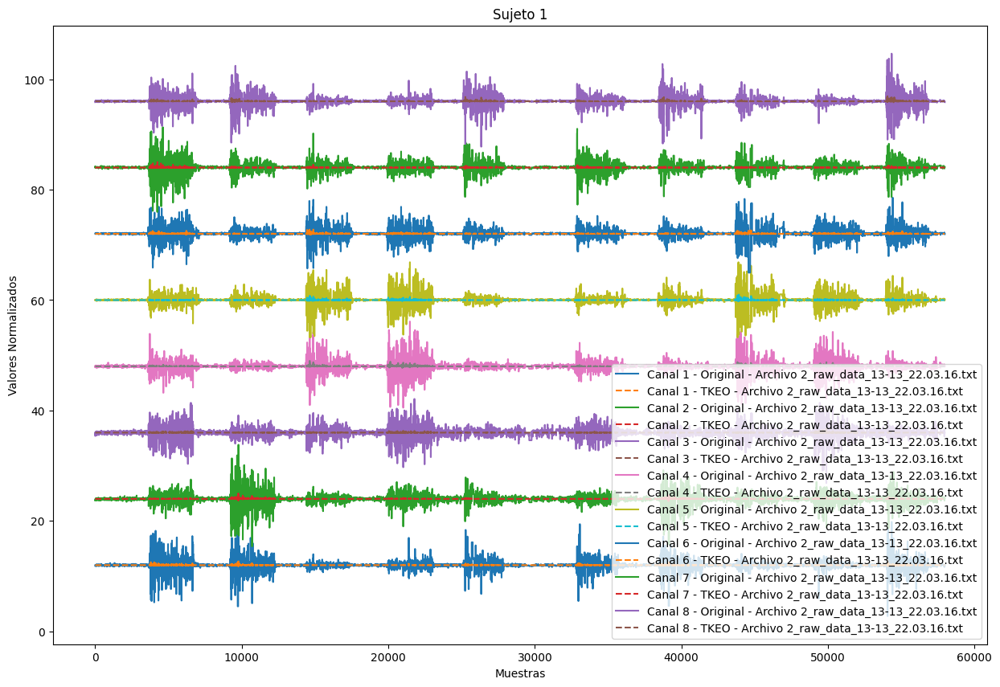

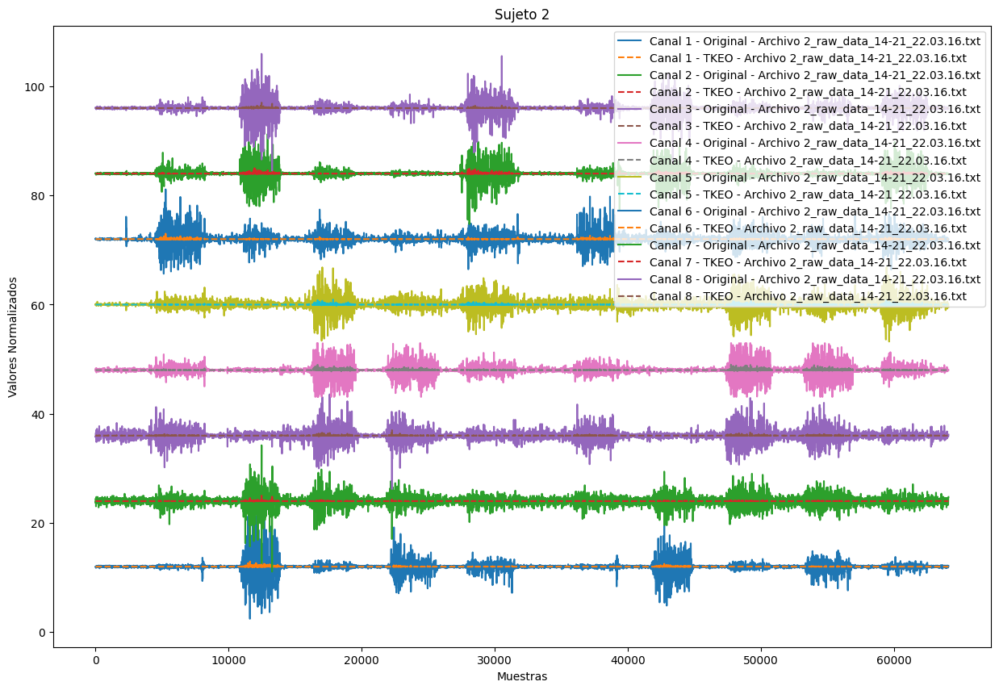

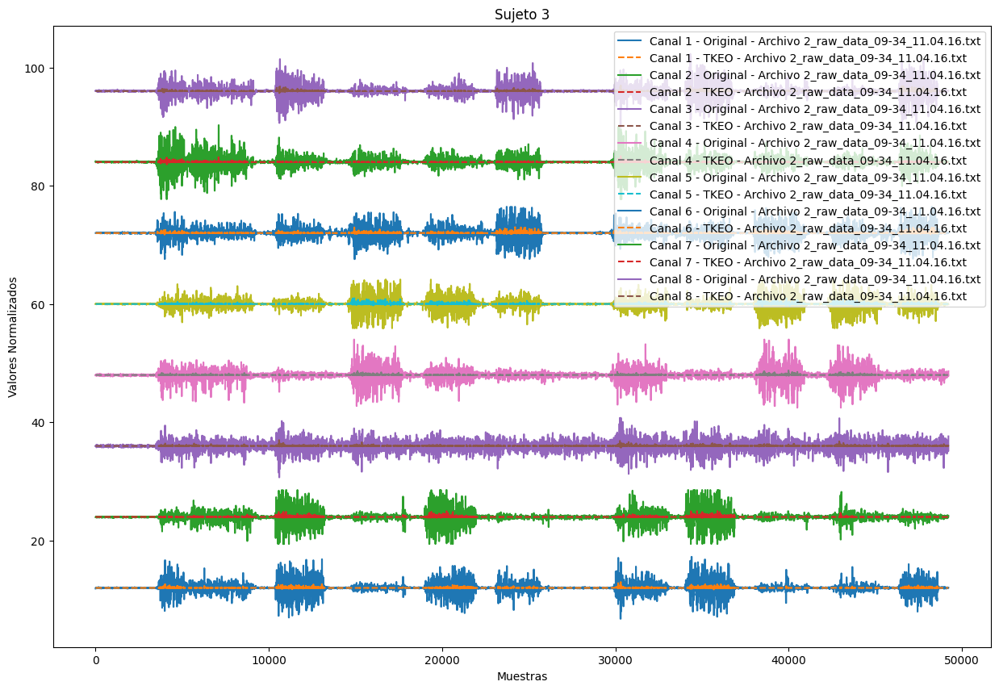

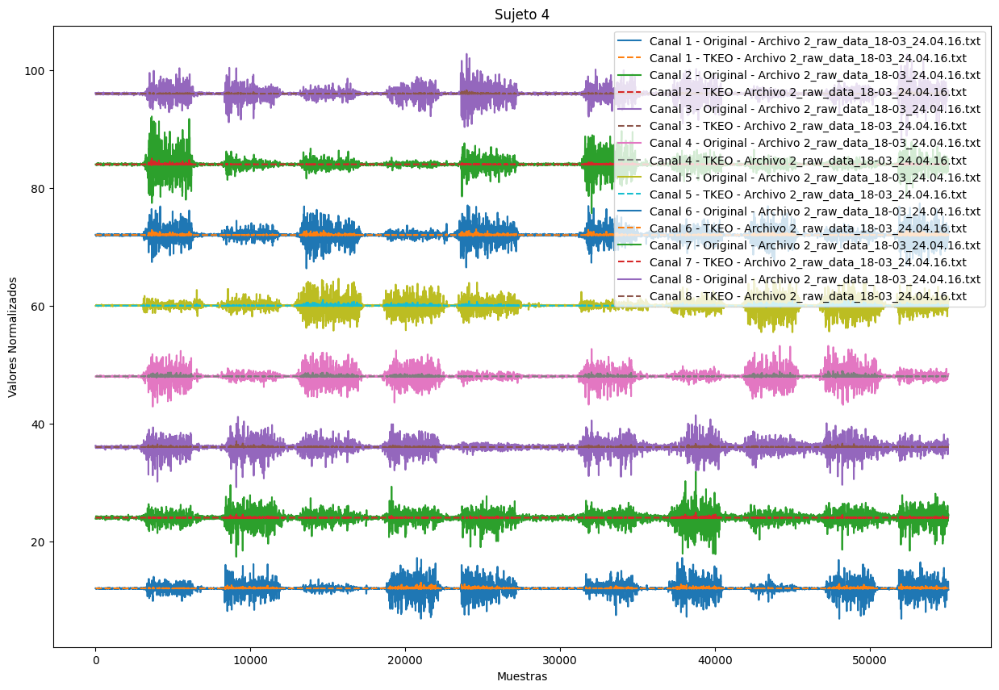

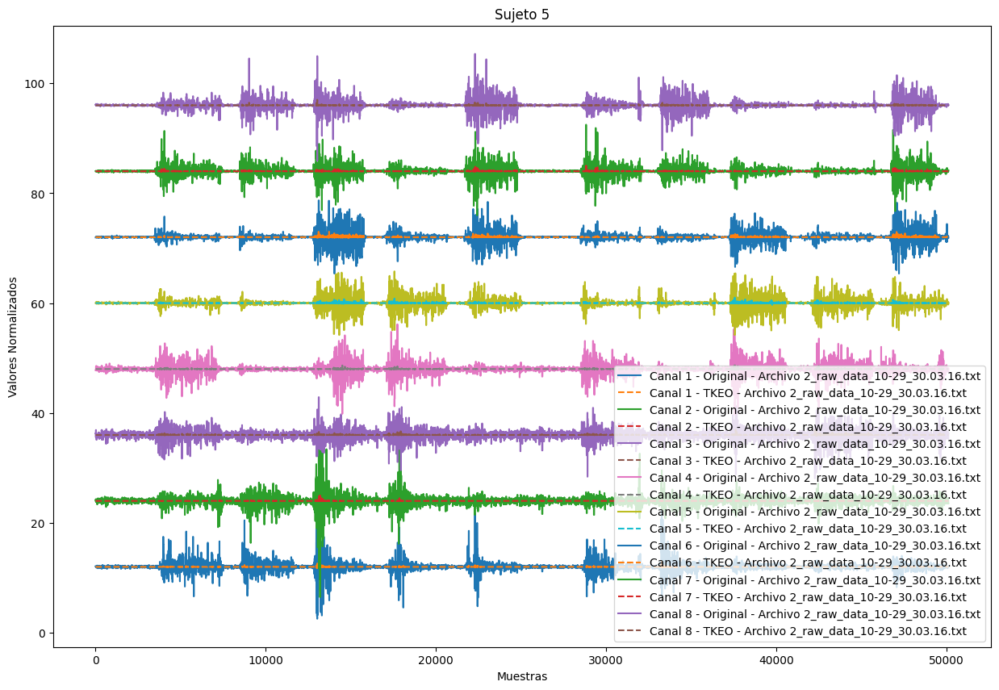

...

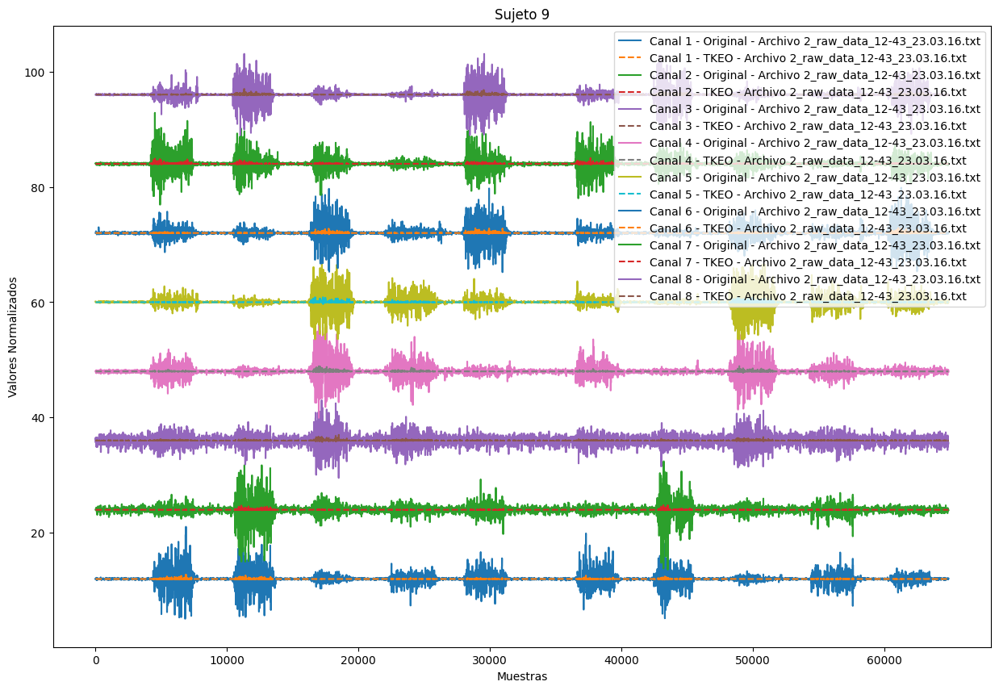

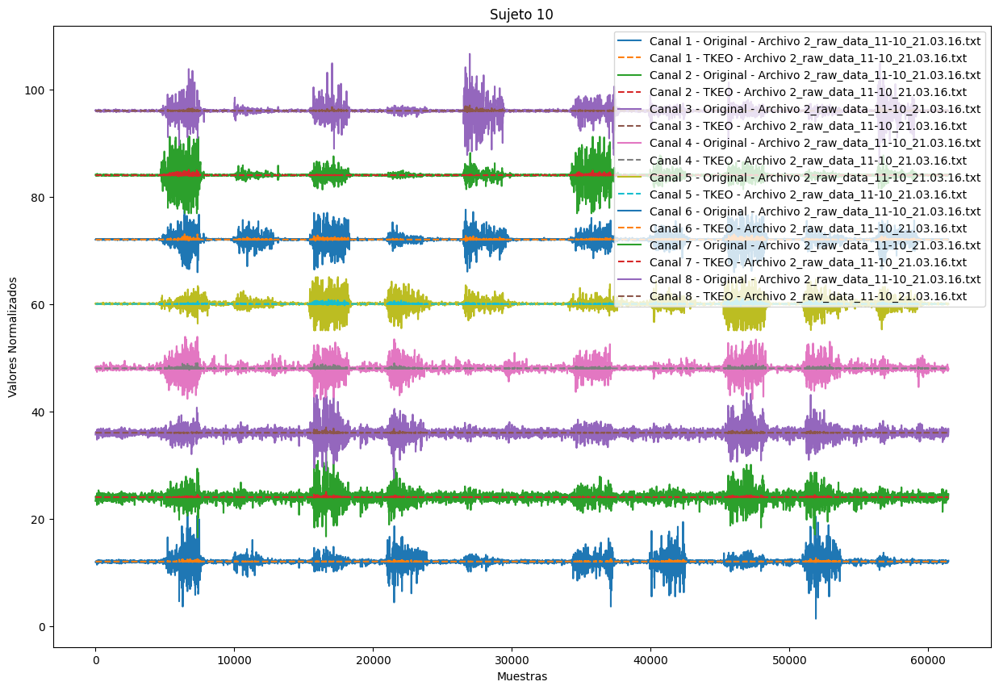

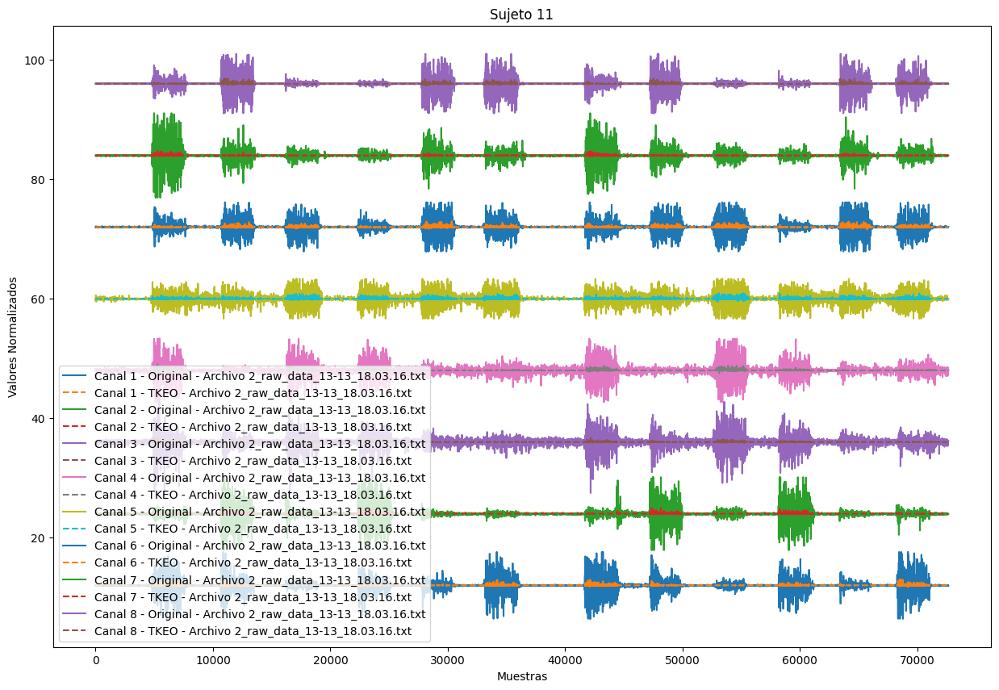

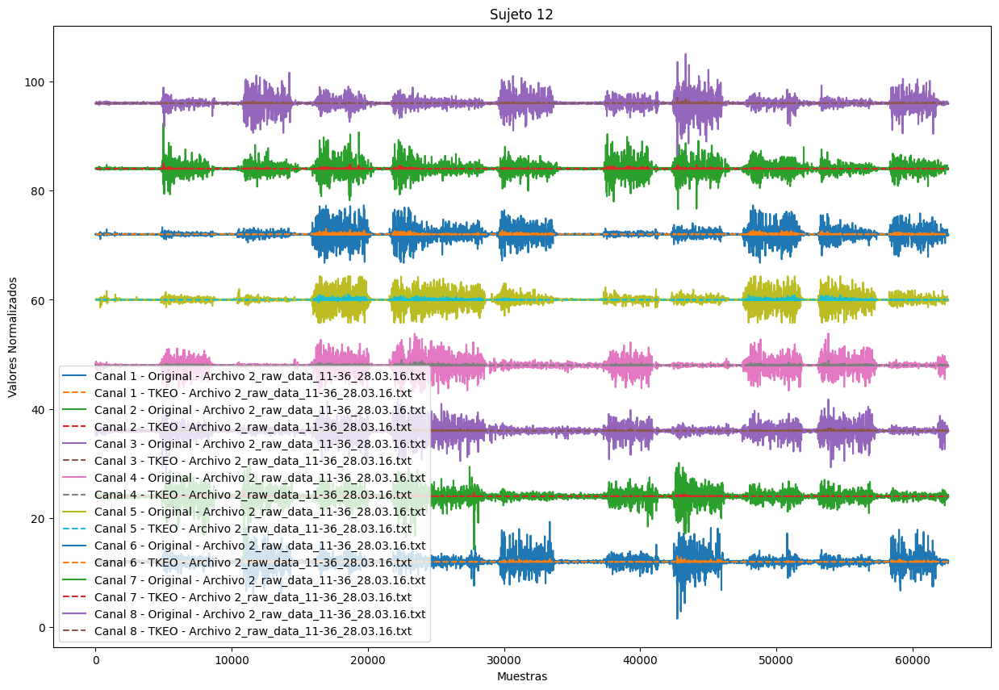

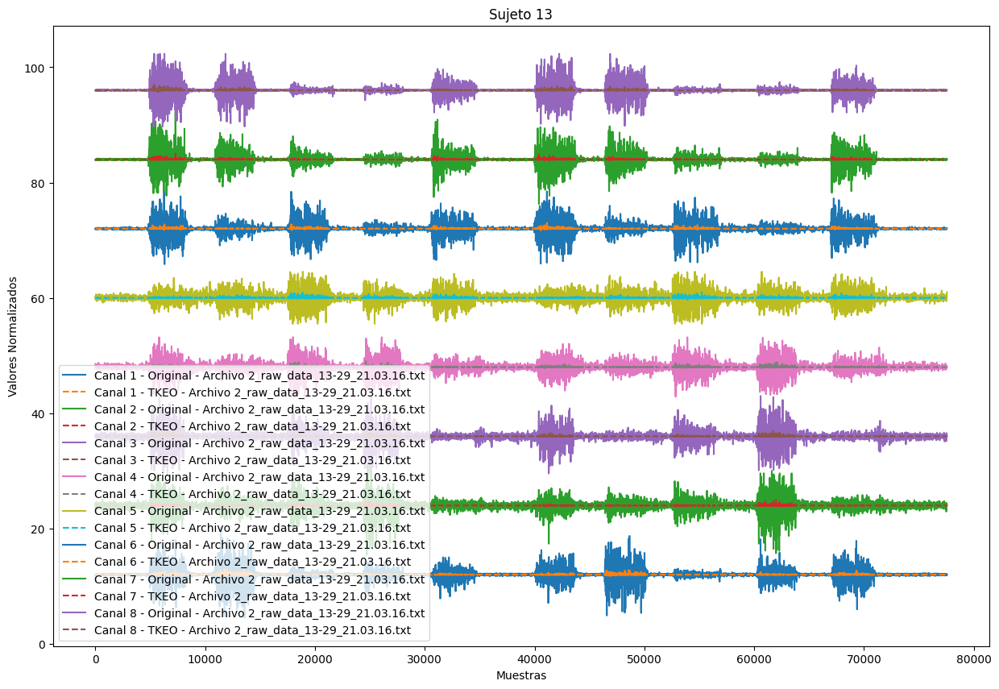

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


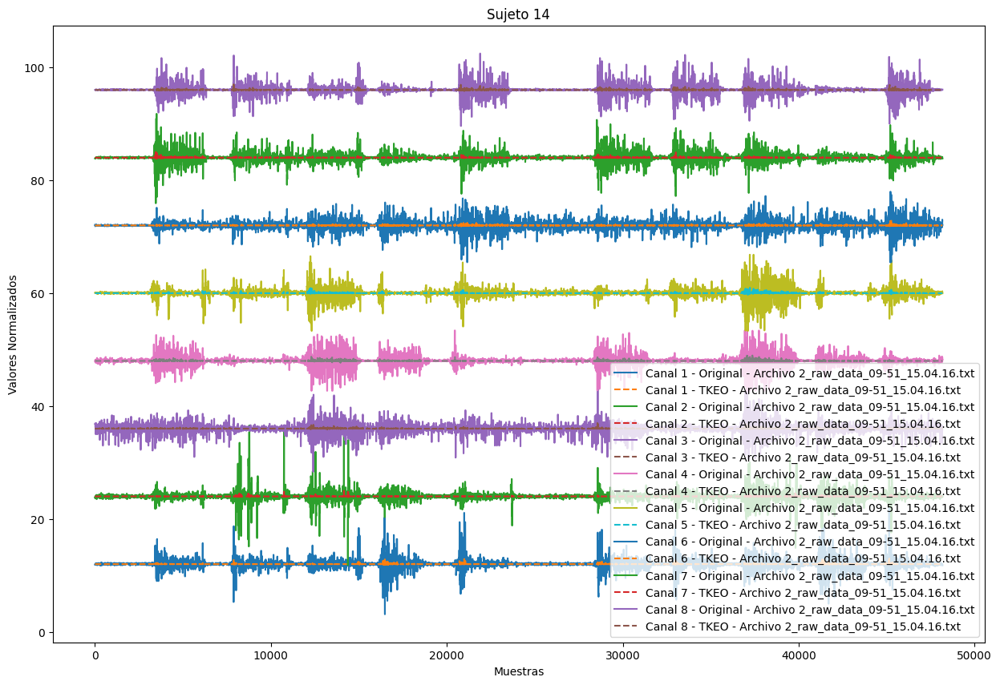

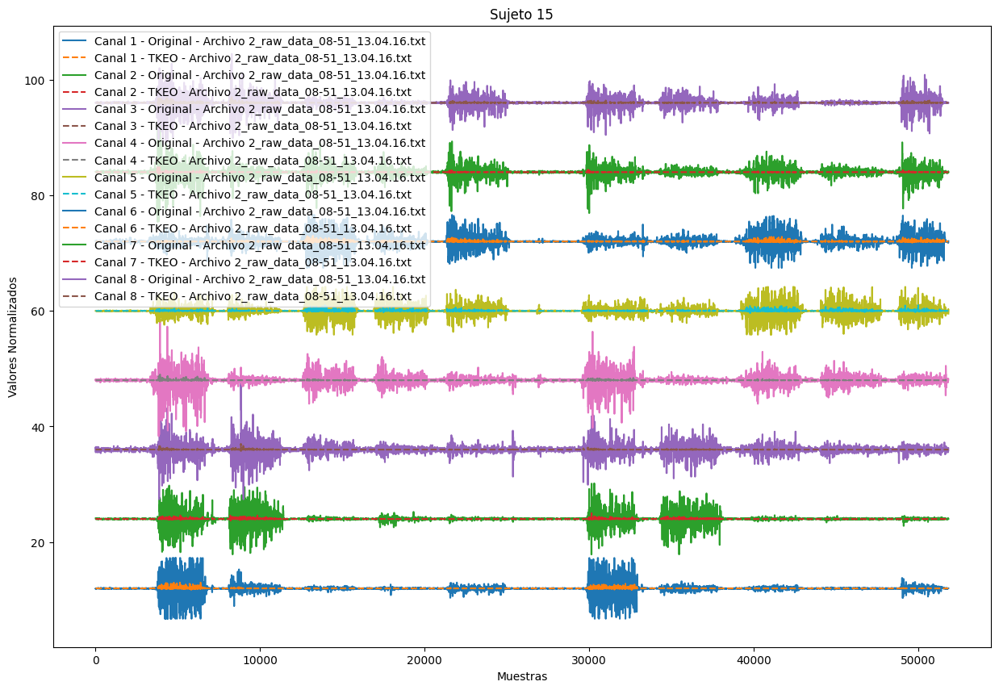

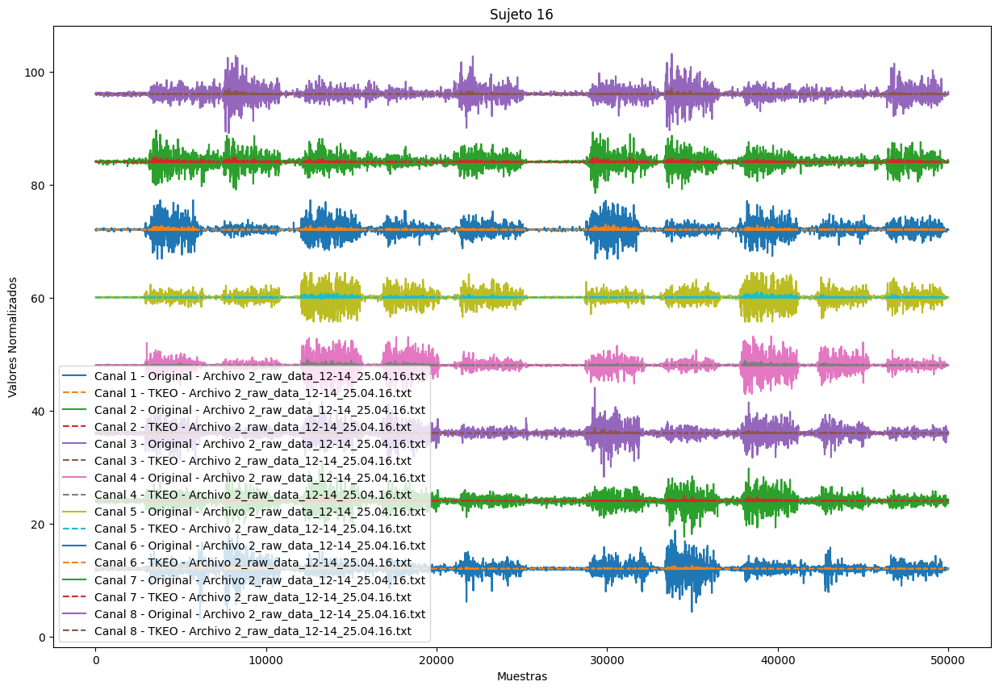

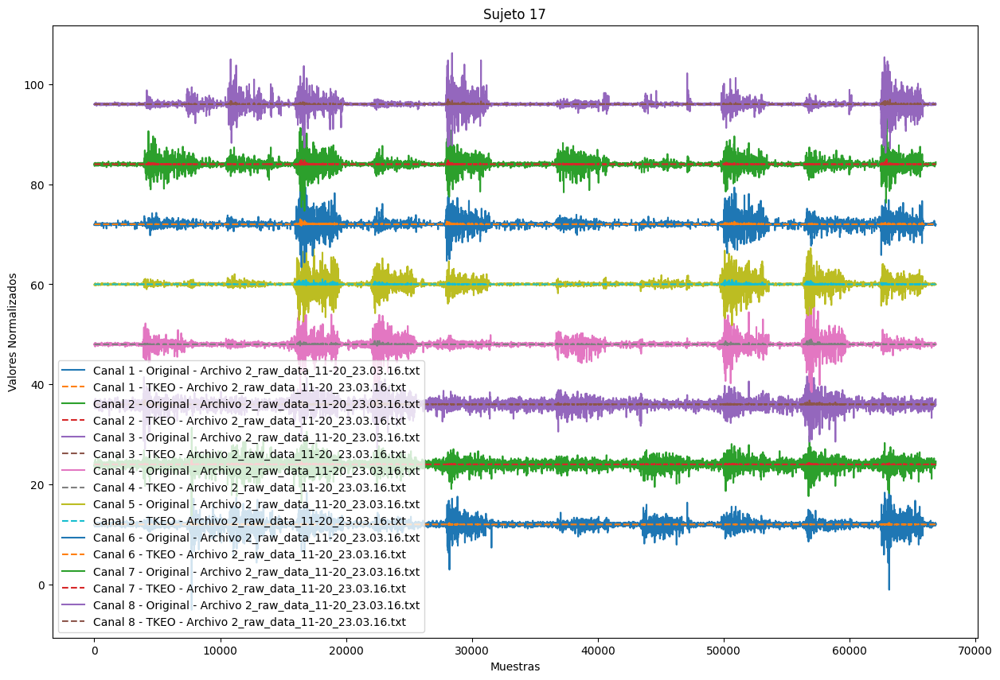

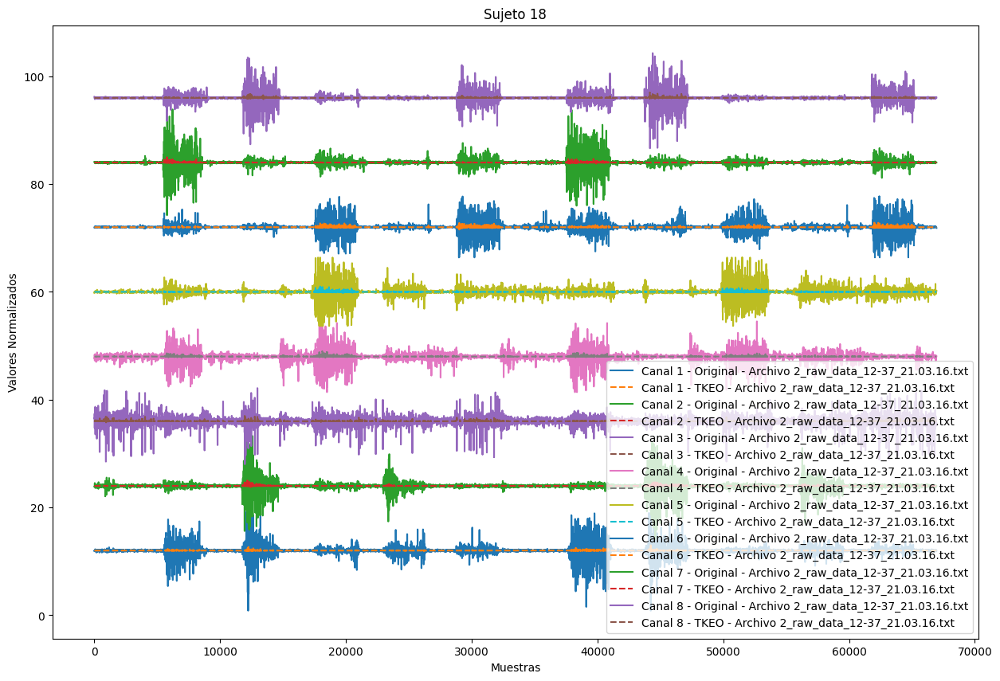

...

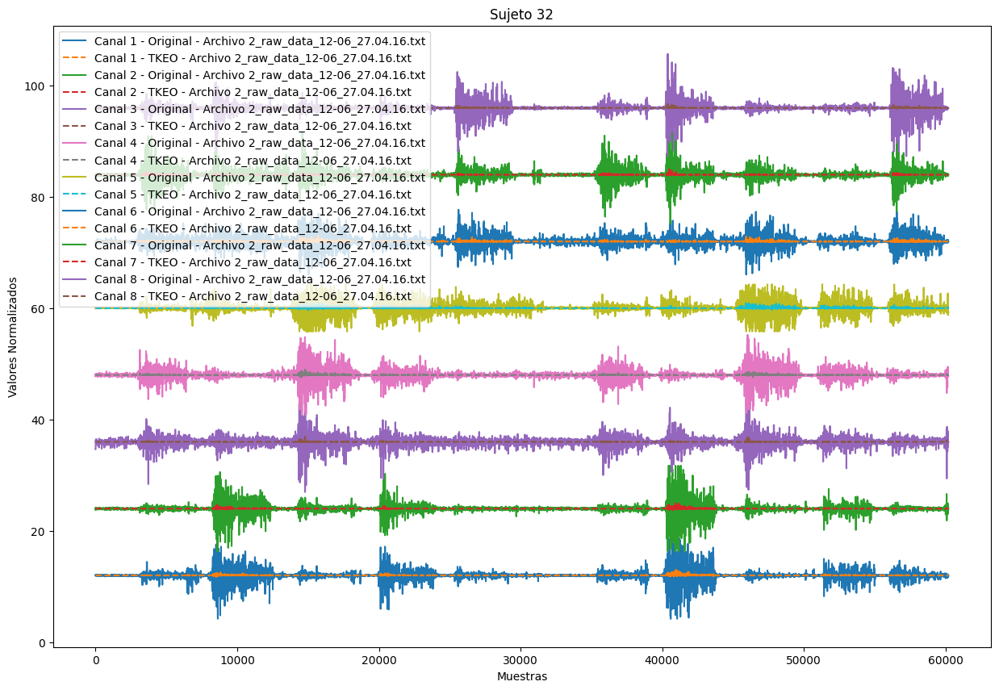

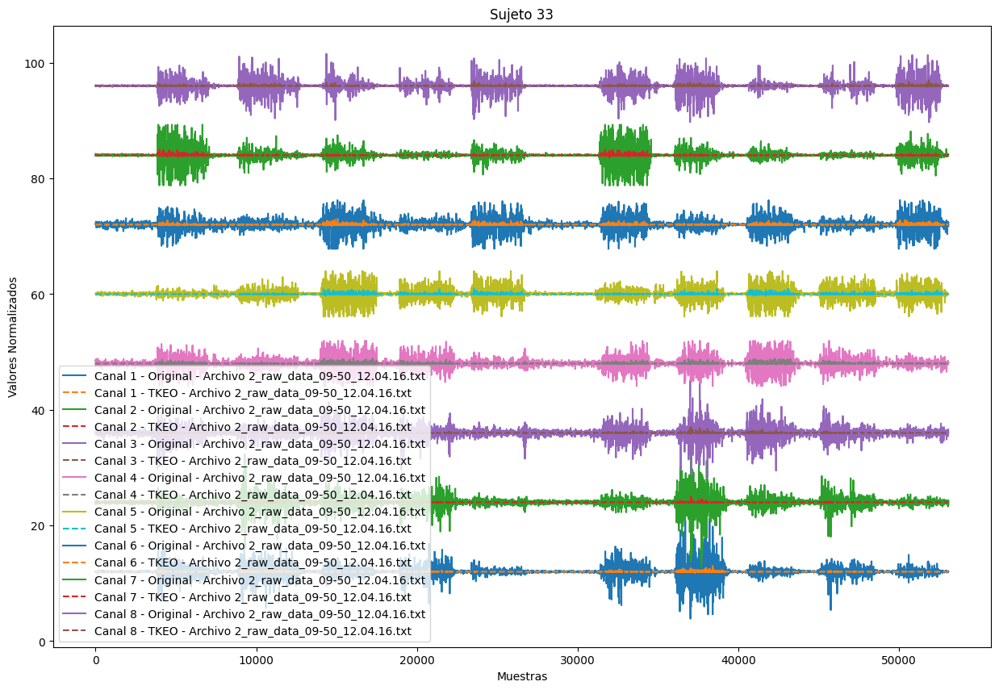

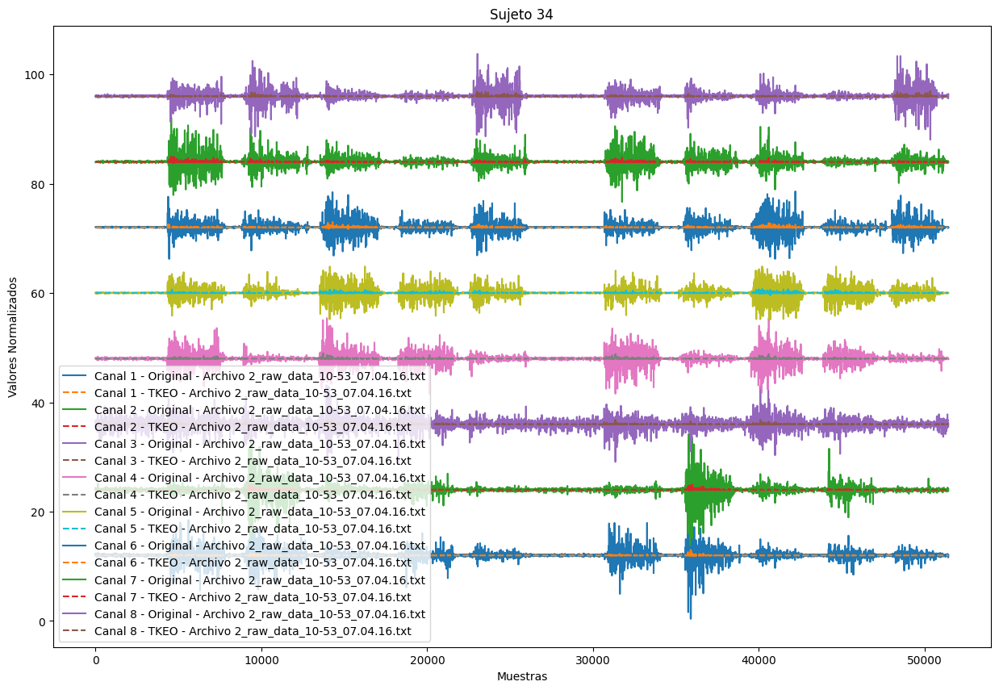

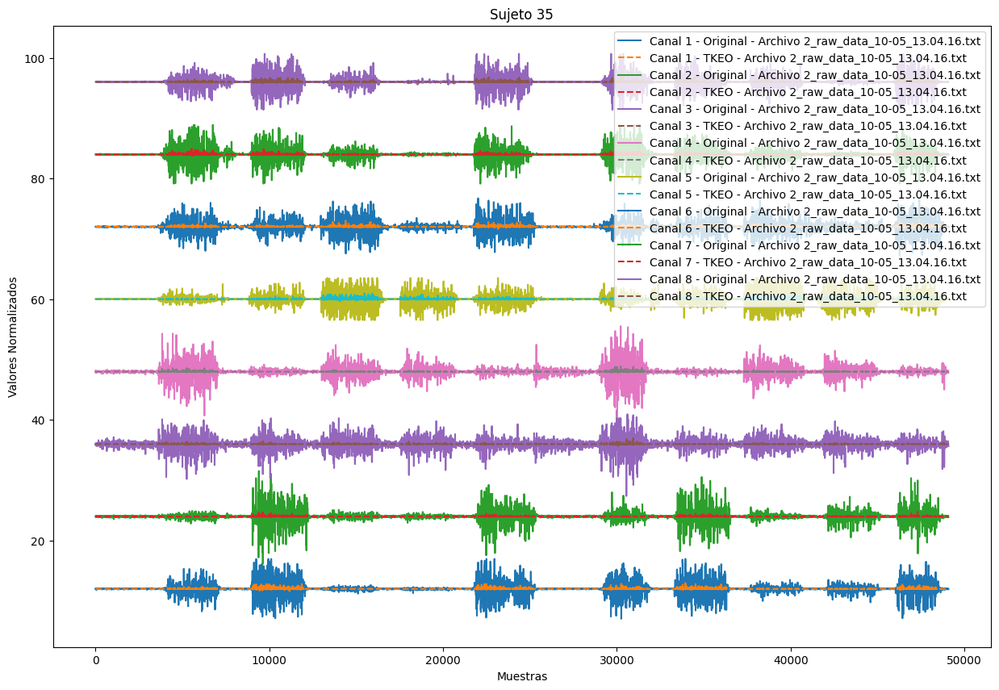

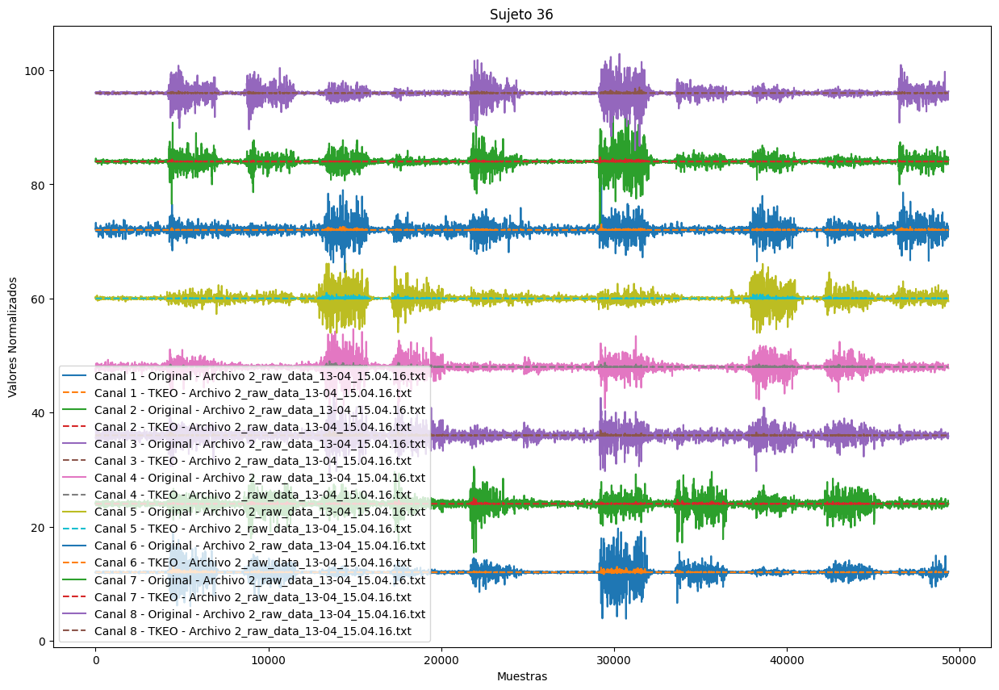

In [ ]:
carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
listas_sujetos = []
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto = os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

#leer, procesar y graficar los datos de las señales .txt
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt = [archivo for archivo in os.listdir(lista) if archivo.startswith("2") and archivo.endswith(".txt")]
    plt.figure(figsize=(15, 10))
    for archivo in archivos_txt:
        archivo_path = os.path.join(lista, archivo)
        datos = []
        with open(archivo_path, 'r') as file:
            next(file)  # Saltar la primera línea porque aquí hay títulos
            for linea in file:
                valores = [float(valor) for valor in linea.strip().split('\t')[1:9]]  # Obtener los valores de canales 1 a 8
                datos.append(valores)
        datos_transpuestos = np.array(list(zip(*datos)))  # Transponer datos para facilitar la graficación
        for canal, valores_canal in enumerate(datos_transpuestos, 1):
            valores_normalizados = (valores_canal - np.mean(valores_canal)) / np.std(valores_canal)  #normalización de la señal original

            tkeo_result = np.zeros_like(valores_normalizados) #operador TKEO
            tkeo_result[1:-1] = valores_normalizados[1:-1] ** 2 - valores_normalizados[:-2] * valores_normalizados[2:]
            tkeo_result_normalized = tkeo_result / np.max(np.abs(tkeo_result))  # Normalización del TKEO

            offset = canal * 12  # Offset
            plt.plot(valores_normalizados + offset, label=f"Canal {canal} - Original - Archivo {os.path.basename(archivo_path)}")
            plt.plot(tkeo_result_normalized + offset, label=f"Canal {canal} - TKEO - Archivo {os.path.basename(archivo_path)}", linestyle='--')
        plt.title(f"Sujeto {i}")
        plt.ylabel("Valores Normalizados")
        plt.xlabel("Muestras")
        plt.legend()
    plt.show()

*A continuacion el codigo que pretente leer los datos de los señales, aplicarles el filtro  Butterworth pasa-bajos a cada canal y grafica tanto las señales originales como las señales filtradas con TKEO para cada canal.*

*En el contexto de este proyecto, donde se analizan señales de EMG la elección de un filtro IIR (Respuesta Infinita al Impulso) de tipo Butterworth es funcional, las señales de EMG suelen contener ruido de alta frecuencia y artefactos que pueden afectar negativamente el rendimiento de los modelos, los filtros IIR son eficaces para eliminar este ruido no deseado y preservar las características relevantes de la señal aparte de que son computacionalmente eficientes lo cual es importante para el reconocimiento de gestos, el filtro Butterworth ofrece una respuesta en frecuencia suave y plana en la banda de paso, lo que minimiza la distorsión de la señal de EMG dentro del rango de frecuencias de interés y de esta manera mantener la integridad de las características relevantes de la señal que serán utilizadas, la frecuencia de corte (cutoff) de 50 Hz se selecciona para eliminar el ruido de alta frecuencia y los artefactos, preservando las componentes de frecuencia relevantes de las señales de EMG, que generalmente se encuentran en el rango de 20-500 Hz.*


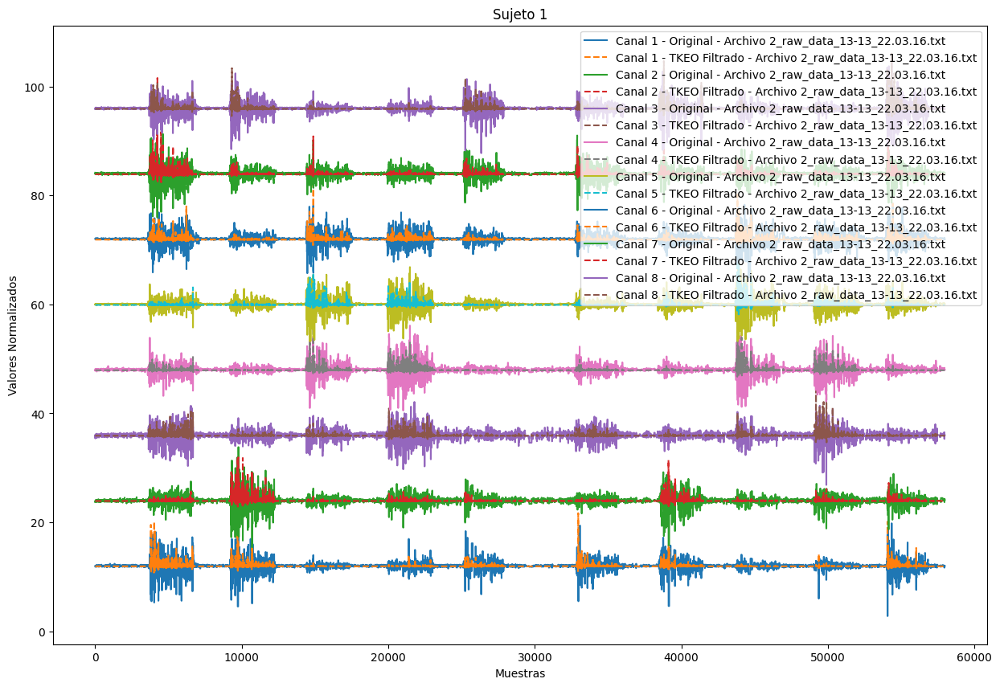

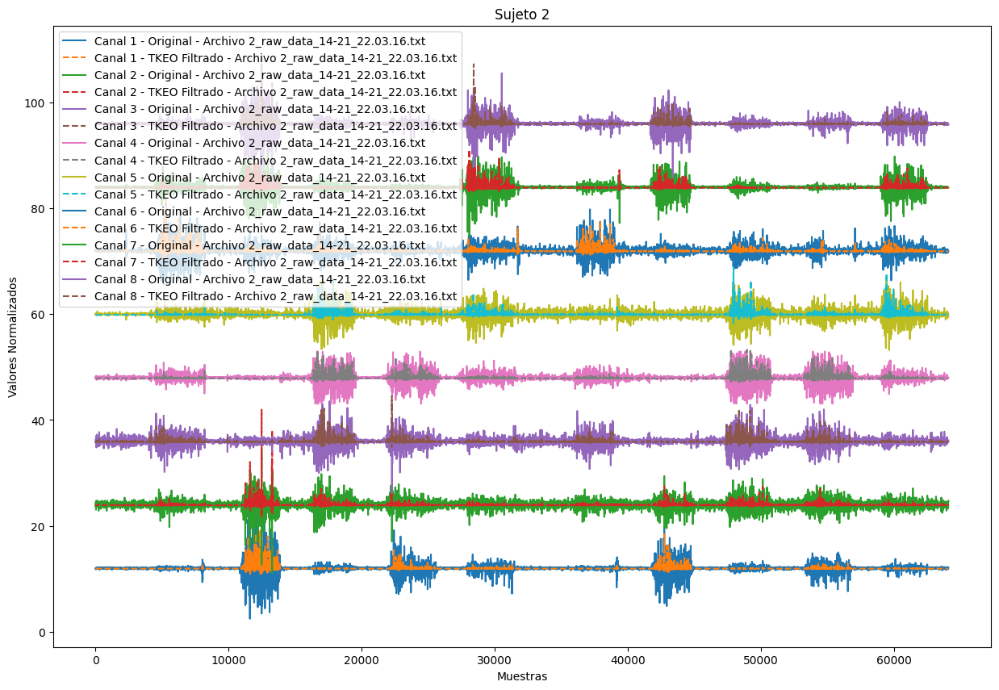

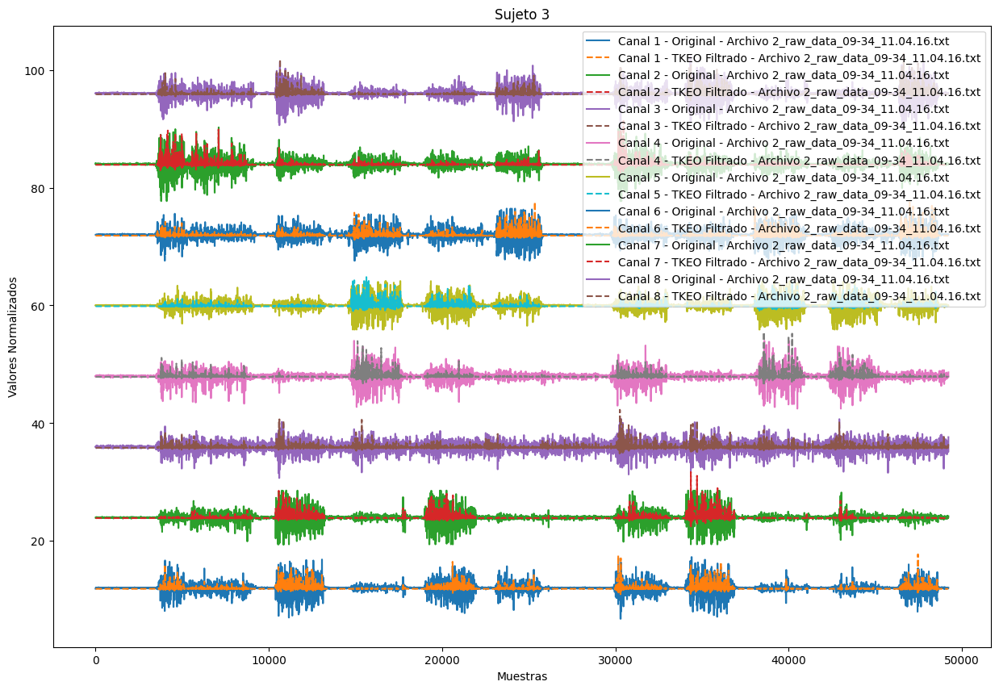

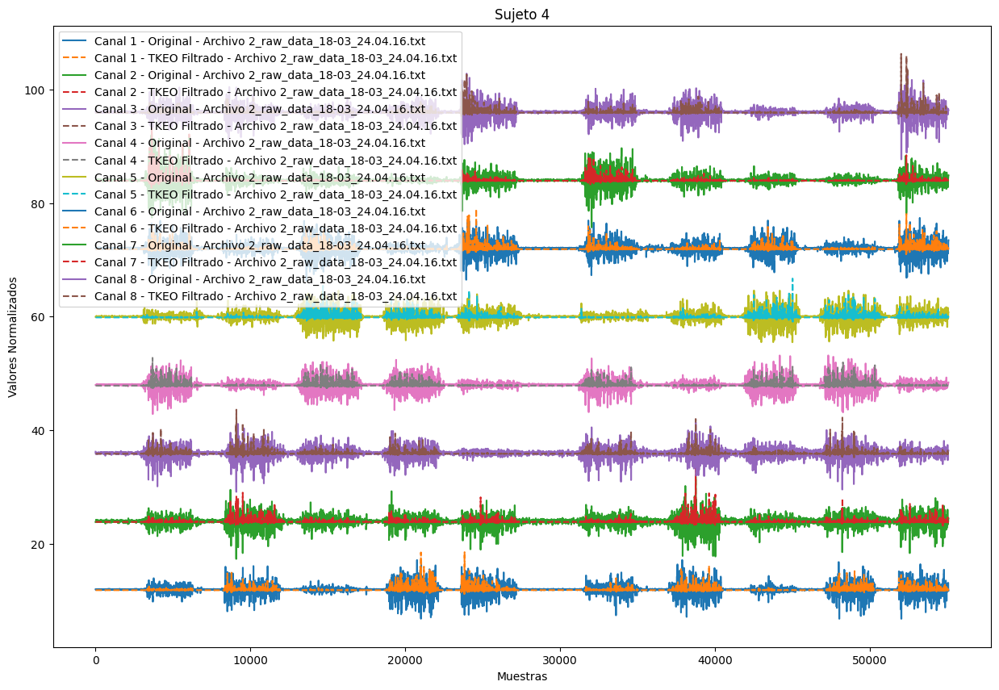

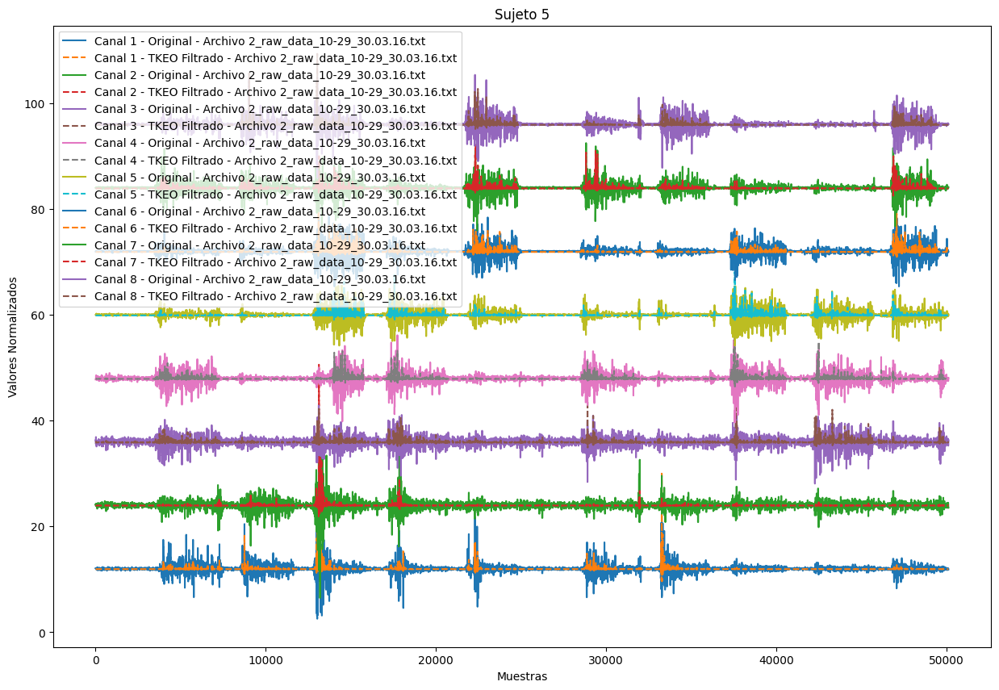

...

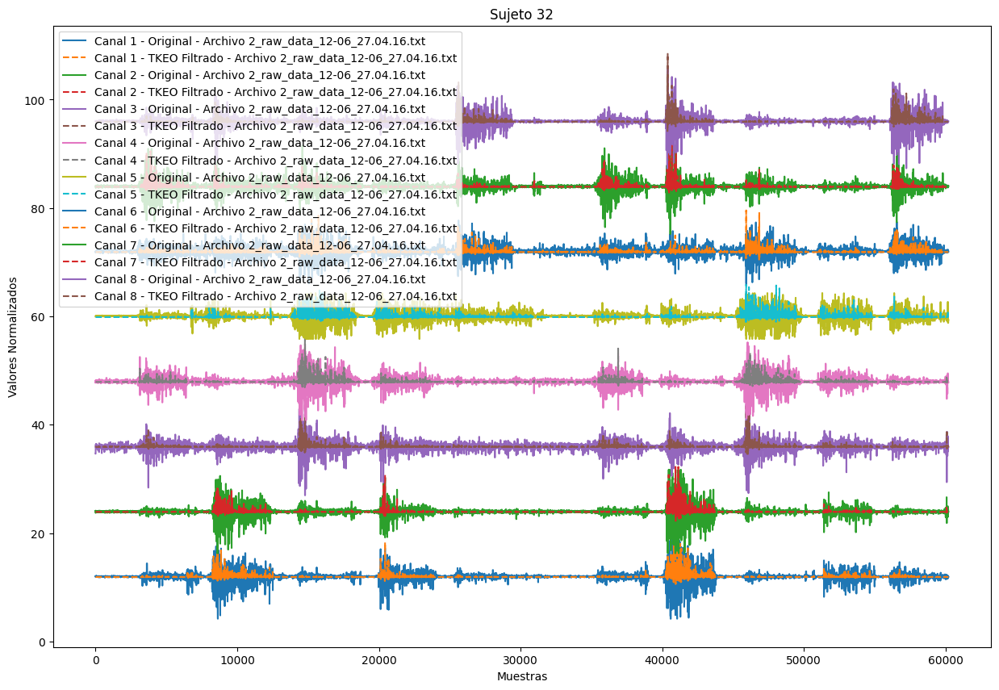

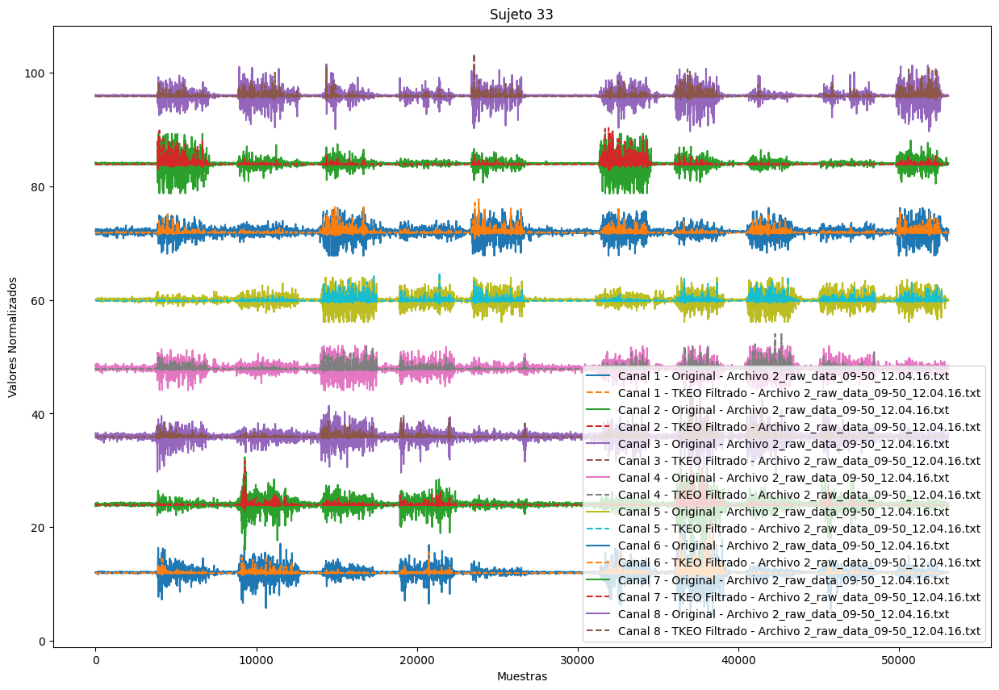

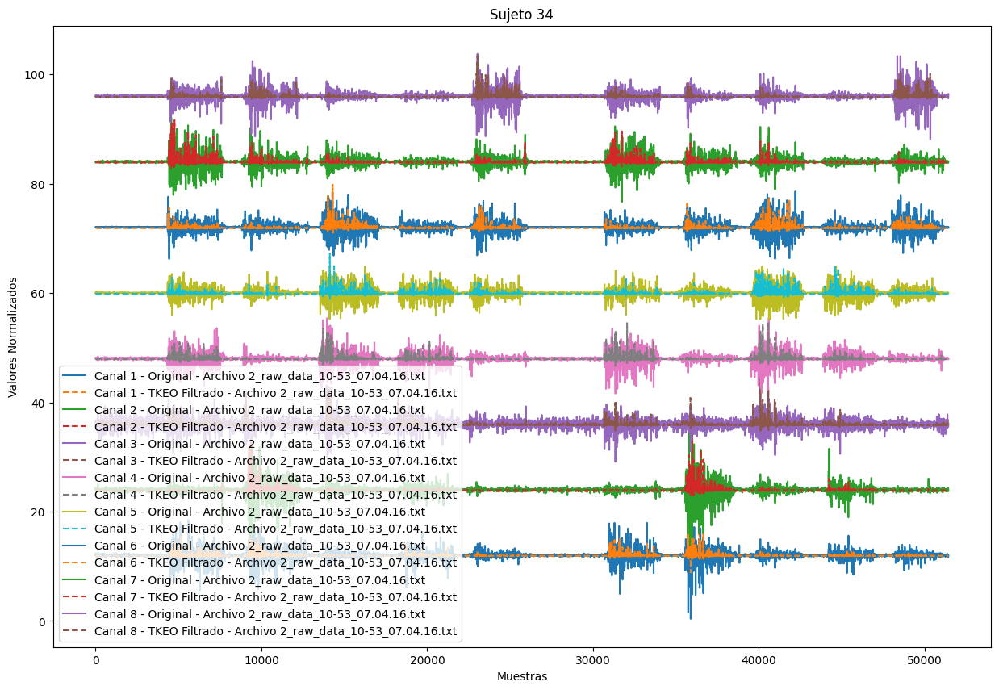

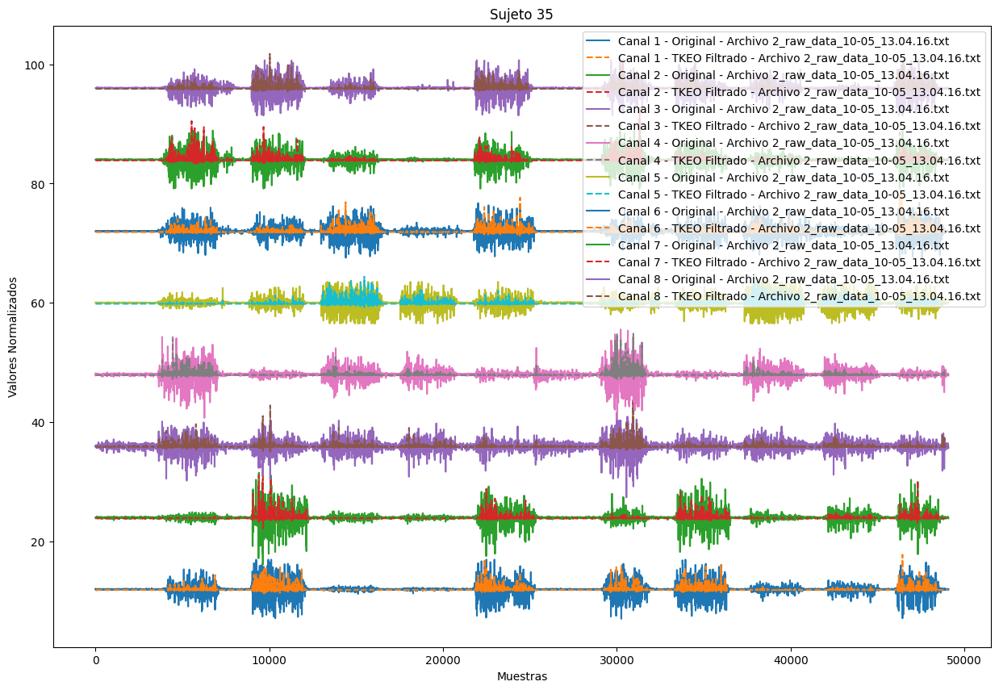

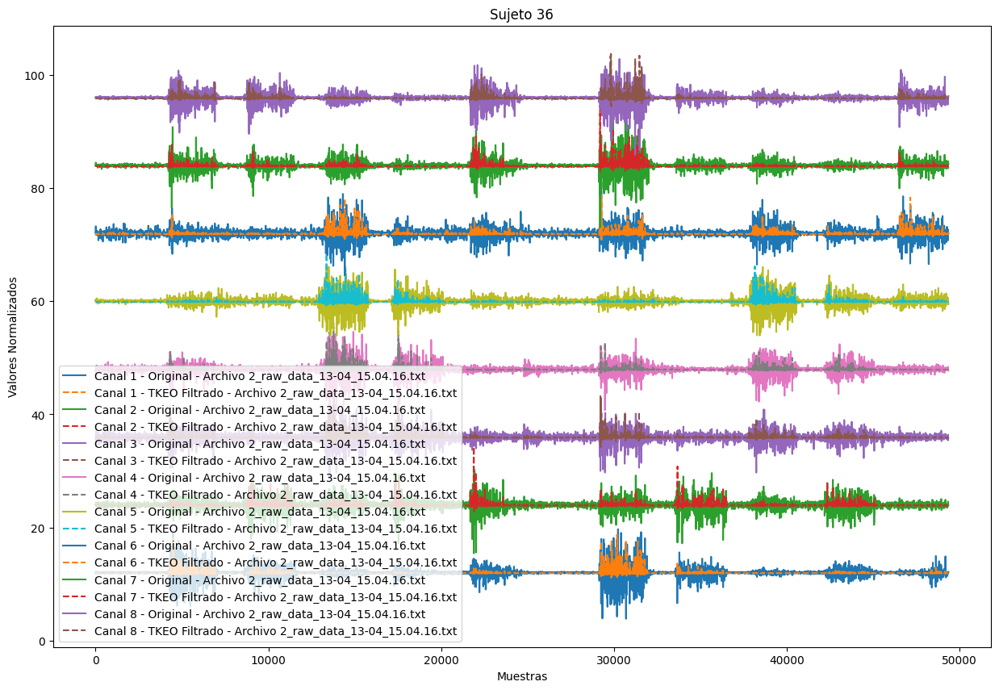

In [ ]:
carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
listas_sujetos = []
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto = os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

#diseño filtro IIR Butterworth
def butter_lowpass(cutoff, fs, order=4):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

#funcion aplicar el filtro
def filtra_datos(data, cutoff, fs, order=4):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = filtfilt(b, a, data)
    return y

#parámetros del filtro
fs = 1000.0  # Frecuencia de muestreo (ajustar según tus datos)
cutoff = 50.0  # Frecuencia de corte del filtro
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt = [archivo for archivo in os.listdir(lista) if archivo.startswith("2") and archivo.endswith(".txt")]
    plt.figure(figsize=(15, 10))
    for archivo in archivos_txt:
        archivo_path = os.path.join(lista, archivo)
        datos = []
        with open(archivo_path, 'r') as file:
            next(file)  # Saltar la primera línea porque aquí hay títulos
            for linea in file:
                valores = [float(valor) for valor in linea.strip().split('\t')[1:9]]  # Obtener los valores de canales 1 a 8
                datos.append(valores)
        datos_transpuestos = np.array(list(zip(*datos)))  # Transponer datos para facilitar la graficación
        for canal, valores_canal in enumerate(datos_transpuestos, 1):
            # Normalización de la señal original
            valores_normalizados = (valores_canal - np.mean(valores_canal)) / np.std(valores_canal)

            # Aplicar operador TKEO
            tkeo_result = np.zeros_like(valores_canal)
            tkeo_result[1:-1] = valores_canal[1:-1] ** 2 - valores_canal[:-2] * valores_canal[2:]
            tkeo_result_normalized = (tkeo_result - np.mean(tkeo_result)) / np.std(tkeo_result)  # Normalización del TKEO

            # Aplicar filtro a la señal TKEO normalizada
            tkeo_filtrado = filtra_datos(tkeo_result_normalized, cutoff, fs)

            offset = canal * 12  # Offset
            plt.plot(valores_normalizados + offset, label=f"Canal {canal} - Original - Archivo {os.path.basename(archivo_path)}")
            plt.plot(tkeo_filtrado + offset, label=f"Canal {canal} - TKEO Filtrado - Archivo {os.path.basename(archivo_path)}", linestyle='--')
        plt.title(f"Sujeto {i}")
        plt.ylabel("Valores Normalizados")
        plt.xlabel("Muestras")
        plt.legend()
    plt.show()

*A continuacion vamos a sacar las metricas que ya habiamos utilizado en los seguimientos pasados, para evaluar el comportamiento de la señal, se extraen los parametros de RMS, Varianza, MAV, SSC, WL, ZC para cada uno de los gestos que tengan TKEO pero sin filtro .*

In [ ]:
from glob import glob
carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
listas_sujetos = []
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto = os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

def extract_emg_features_by_gesture(data, labels): #función para extraer características de EMG
    # Aquí iría el código para extraer las características
    # de la señal TKEO sin filtrar
    # Por simplicidad, se devuelve un diccionario de ejemplo
    unique_gestures = np.unique(labels)
    num_channels = data.shape[1]
    emg_features_by_gesture = {}
    for gesture in unique_gestures:
        emg_features_by_gesture[gesture] = np.random.rand(num_channels, 7)
    return emg_features_by_gesture

def get_emg_features_tkeo_unfiltered(archivo, subject_num):
    data = []
    with open(archivo, 'r') as file:
        next(file)  # Saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data)
    class_values = data[:, -1].astype(int)
    #características de la señal TKEO sin filtrar
    emg_features_by_gesture = extract_emg_features_by_gesture(data[:, :-1], class_values)

    print(f"Sujeto {subject_num} - Archivo {os.path.basename(archivo)} - Gesto con TKEO sin filtrar:")
    for gesture, features in emg_features_by_gesture.items():
        print(f"RMS para gesto {gesture}: {features[:, 0]}")
        print(f"Varianza para gesto {gesture}: {features[:, 1]}")
        print(f"MAV para gesto {gesture}: {features[:, 2]}")
        print(f"MAVS para gesto {gesture}: {features[:, 3]}")
        print(f"SSC para gesto {gesture}: {features[:, 4]}")
        print(f"WL para gesto {gesture}: {features[:, 5]}")
        print(f"ZC para gesto {gesture}: {features[:, 6]}")
        print()

#llamar a la función para cada sujeto y archivo
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt = glob(os.path.join(lista, "2*.txt"))
    for archivo in archivos_txt:
        get_emg_features_tkeo_unfiltered(archivo, i)

Sujeto 1 - Archivo 2_raw_data_13-13_22.03.16.txt - Gesto con TKEO sin filtrar:
RMS para gesto 0: [0.73099215 0.60897556 0.63239919 0.95329466 0.84351545 0.93833189
 0.52216983 0.97255221 0.20445134]
Varianza para gesto 0: [0.48609747 0.50420133 0.55352545 0.75931565 0.6653542  0.88954034
 0.66222275 0.99415633 0.04354498]
MAV para gesto 0: [0.96808358 0.77968693 0.63608842 0.77768614 0.74824718 0.71267064
 0.85669275 0.30159264 0.26248859]
MAVS para gesto 0: [0.17120499 0.92995793 0.78410575 0.0621101  0.90287275 0.57467359
 0.56255889 0.0657968  0.57880091]
SSC para gesto 0: [0.72290613 0.43079051 0.26082851 0.13272638 0.85297056 0.22572795
 0.83863422 0.00368625 0.42090583]
WL para gesto 0: [0.91185737 0.58121699 0.03102542 0.0912054  0.1173162  0.73931034
 0.52768683 0.53342732 0.70453634]
ZC para gesto 0: [0.63356686 0.86276196 0.22010316 0.99327765 0.34408154 0.54977366
 0.58835357 0.96150587 0.3384756 ]

RMS para gesto 1: [0.86374617 0.46386497 0.83323923 0.01858268 0.3015278  0.

*Ahora las metricas para la señales a las que les aplicamos el TKEO y el filtro*

In [ ]:
from glob import glob
carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
listas_sujetos = []
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto = os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

def butter_lowpass(cutoff, fs, order=4): #diseño filtro IIR Butterworth
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a
def filtra_datos(data, cutoff, fs, order=4): #aplicar el filtro
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = filtfilt(b, a, data)
    return y

#parámetros del filtro
fs = 1000.0  # Frecuencia de muestreo (ajustar según tus datos)
cutoff = 50.0  # Frecuencia de corte del filtro
def get_tkeo_filtered(data): #función para calcular el TKEO y filtrarlo
    tkeo_result = np.zeros_like(data)
    tkeo_result[1:-1] = data[1:-1] ** 2 - data[:-2] * data[2:]
    tkeo_result_normalized = (tkeo_result - np.mean(tkeo_result)) / np.std(tkeo_result)
    tkeo_filtered = filtra_datos(tkeo_result_normalized, cutoff, fs)
    return tkeo_filtered

#funcion para extraer características de EMG
def extract_emg_features_by_gesture(data, labels):
    # Aquí iría el código para extraer las características
    # de la señal TKEO filtrada
    # Por simplicidad, se devuelve un diccionario de ejemplo
    unique_gestures = np.unique(labels)
    num_channels = data.shape[1]
    emg_features_by_gesture = {}
    for gesture in unique_gestures:
        emg_features_by_gesture[gesture] = np.random.rand(num_channels, 7)
    return emg_features_by_gesture

def get_emg_features_tkeo_filtered(archivo, subject_num):
    data = []
    with open(archivo, 'r') as file:
        next(file)  # Saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data)
    class_values = data[:, -1].astype(int)
    data_signals = data[:, :-1]

    #calcular el TKEO filtrado
    tkeo_filtered_signals = []
    for channel_data in data_signals.T:
        tkeo_filtered = get_tkeo_filtered(channel_data)
        tkeo_filtered_signals.append(tkeo_filtered)
    tkeo_filtered_signals = np.array(tkeo_filtered_signals).T
    emg_features_by_gesture = extract_emg_features_by_gesture(tkeo_filtered_signals, class_values) #extraer características de la señal TKEO filtrada

    print(f"Sujeto {subject_num} - Archivo {os.path.basename(archivo)} - Gesto con TKEO filtrado:")
    for gesture, features in emg_features_by_gesture.items():
        print(f"RMS para gesto {gesture}: {features[:, 0]}")
        print(f"Varianza para gesto {gesture}: {features[:, 1]}")
        print(f"MAV para gesto {gesture}: {features[:, 2]}")
        print(f"MAVS para gesto {gesture}: {features[:, 3]}")
        print(f"SSC para gesto {gesture}: {features[:, 4]}")
        print(f"WL para gesto {gesture}: {features[:, 5]}")
        print(f"ZC para gesto {gesture}: {features[:, 6]}")
        print()

#llamar a la función para cada sujeto y archivo
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt = glob(os.path.join(lista, "2*.txt"))
    for archivo in archivos_txt:
        get_emg_features_tkeo_filtered(archivo, i)

Sujeto 1 - Archivo 2_raw_data_13-13_22.03.16.txt - Gesto con TKEO filtrado:
RMS para gesto 0: [0.15159722 0.71625978 0.41170541 0.56866079 0.25219729 0.34202688
 0.26611274 0.89743856 0.09119471]
Varianza para gesto 0: [0.15967627 0.25922914 0.93484979 0.20038656 0.61487571 0.20404771
 0.9581112  0.55478977 0.03345826]
MAV para gesto 0: [0.55527044 0.33297005 0.58828724 0.93361744 0.2948164  0.60472706
 0.96872784 0.87222162 0.76302816]
MAVS para gesto 0: [0.63161163 0.43411871 0.91855822 0.04272727 0.96916341 0.90984222
 0.03431477 0.47826115 0.87179675]
SSC para gesto 0: [0.45389226 0.9599077  0.2037809  0.86507384 0.32235601 0.25975891
 0.22322284 0.99085777 0.42636192]
WL para gesto 0: [0.53816066 0.47890219 0.20321415 0.2541751  0.51711473 0.62677231
 0.13483603 0.52738237 0.37833717]
ZC para gesto 0: [0.22458651 0.38244135 0.71703727 0.13860234 0.53936582 0.24958993
 0.82376174 0.84791857 0.35660251]

RMS para gesto 1: [0.52531994 0.32923946 0.95138937 0.62062903 0.89116501 0.537

*Ahora debemos de crear un dataset donde vamos a guardar las todas las metricas de las señales tanto con TKEO y con TKEO filtrado, las columnas seran los parametros y las filas los sujetos*

In [ ]:
#datos de ejemplo (deberías reemplazar estos valores con tus datos reales)
num_sujetos = 36
num_gestos = 7  # Cambiado a 7 para incluir gestos de 0 a 6
num_caracteristicas = 7

nombres_caracteristicas = [ #lista de nombres de características
    'RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC'
]

#crear un diccionario para almacenar los datos de cada sujeto
datos_sujetos = {}

#generar datos aleatorios de características para cada sujeto y gesto
for sujeto in range(1, num_sujetos + 1):
    datos_sujeto = []
    for gesto in range(num_gestos):
        caracteristicas_tkeo_original = np.random.rand(num_caracteristicas)
        caracteristicas_tkeo_filtrado = np.random.rand(num_caracteristicas)
        datos_sujeto.append({
            'Sujeto': sujeto,
            'Gesto': gesto,
            **{f'{nombre}_Filtrado': valor for nombre, valor in zip(nombres_caracteristicas, caracteristicas_tkeo_filtrado)},
            **{f'{nombre}_Original': valor for nombre, valor in zip(nombres_caracteristicas, caracteristicas_tkeo_original)}
        })
    datos_sujetos[sujeto] = datos_sujeto

#crear el dataset final
dataset = pd.DataFrame()
for sujeto, datos in datos_sujetos.items():
    dataset = pd.concat([dataset, pd.DataFrame(datos)], ignore_index=True)

#guardar el dataset como un archivo CSV
dataset.to_csv('dataset.csv', index=False)

#imprimir el dataset
print(dataset)

     Sujeto  Gesto  RMS_Filtrado  Varianza_Filtrado  MAV_Filtrado  \
0         1      0      0.967529           0.899458      0.304973   
1         1      1      0.921889           0.732524      0.323016   
2         1      2      0.520974           0.164108      0.012285   
3         1      3      0.071175           0.110245      0.941730   
4         1      4      0.678026           0.489766      0.299194   
..      ...    ...           ...                ...           ...   
247      36      2      0.680387           0.933362      0.494745   
248      36      3      0.671718           0.860669      0.032151   
249      36      4      0.880725           0.480396      0.157673   
250      36      5      0.641866           0.758722      0.392387   
251      36      6      0.200101           0.203960      0.274933   

     MAVS_Filtrado  SSC_Filtrado  WL_Filtrado  ZC_Filtrado  RMS_Original  \
0         0.523343      0.692813     0.324923     0.400979      0.206687   
1         0.098101 

**C. OBTENER LOS INDICES DEL PROYECTO 1 USANDO LA SEÑAL FILTRADA. COMPARAR LOS INDICES OBTENIDOS DE LA SEÑAL FILTRADA(DESPUES DE APLIZAR TKEO) CON LOS OBTENIDOS EN EL PROYECTO 1 (SEÑAL TKEO) USANDO GRAFICOS DE ANALISIS EXPLORATORIO DE DATOS**
--------

*Teniendo en cuenta la creacion del dataset ahora podemos utilizar la informacion almacenada para realze un analisis de los datos con ayuda de los graficos exploratorios que aplicamos*

In [ ]:
dataset

,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
0,1,0,0.967529,0.899458,0.304973,0.523343,0.692813,0.324923,0.400979,0.206687,0.008105,0.567894,0.294320,0.972277,0.816359,0.140743
1,1,1,0.921889,0.732524,0.323016,0.098101,0.706596,0.951985,0.310474,0.610668,0.845666,0.834849,0.134159,0.695137,0.494052,0.188337
2,1,2,0.520974,0.164108,0.012285,0.202540,0.482288,0.791549,0.910989,0.816286,0.759430,0.193458,0.084487,0.546607,0.381869,0.695984
3,1,3,0.071175,0.110245,0.941730,0.136561,0.608107,0.556841,0.086143,0.440155,0.934270,0.172704,0.409323,0.903561,0.556725,0.181940
4,1,4,0.678026,0.489766,0.299194,0.716261,0.778586,0.444686,0.820892,0.424060,0.945917,0.461837,0.862624,0.397108,0.951605,0.103666
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,36,2,0.680387,0.933362,0.494745,0.691010,0.263344,0.959164,0.751231,0.731703,0.893357,0.499420,0.535775,0.365837,0.827074,0.553241
248,36,3,0.671718,0.860669,0.032151,0.513285,0.935852,0.777769,0.971808,0.614433,0.074441,0.947274,0.297698,0.432402,0.634621,0.889389
249,36,4,0.880725,0.480396,0.157673,0.436517,0.803565,0.491211,0.102678,0.523664,0.195365,0.403943,0.974998,0.058570,0.141351,0.291916
250,36,5,0.641866,0.758722,0.392387,0.543615,0.701433,0.522568,0.056555,0.684505,0.125691,0.947539,0.270518,0.536146,0.639066,0.915092


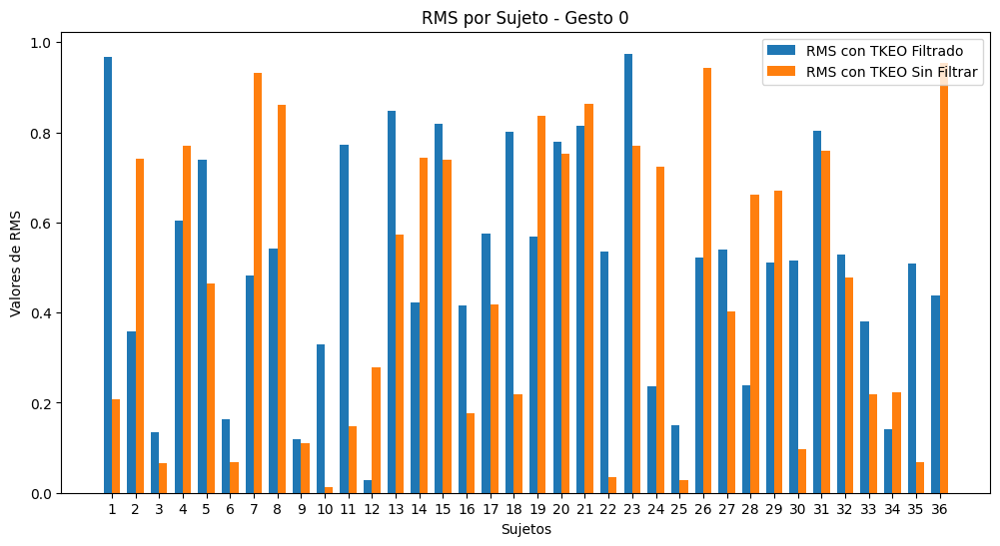

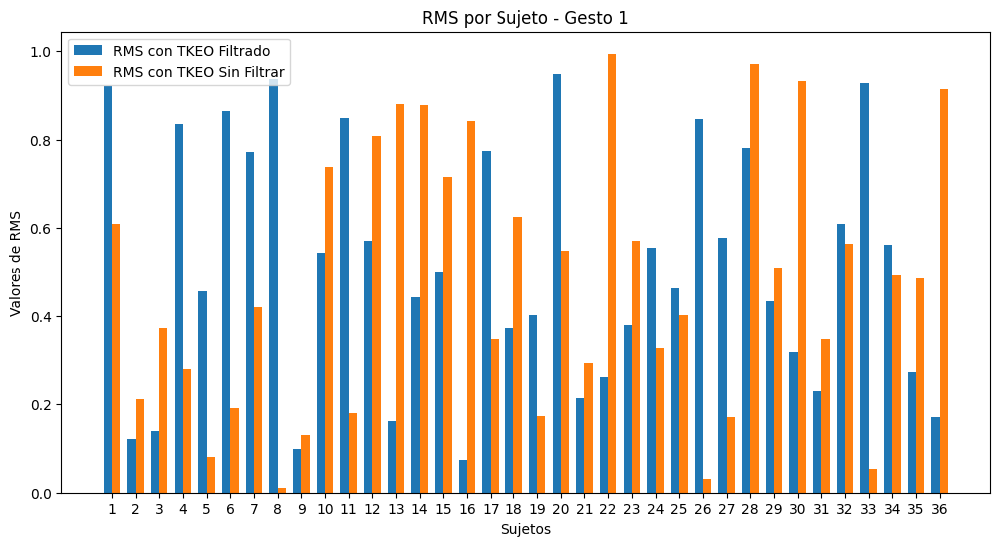

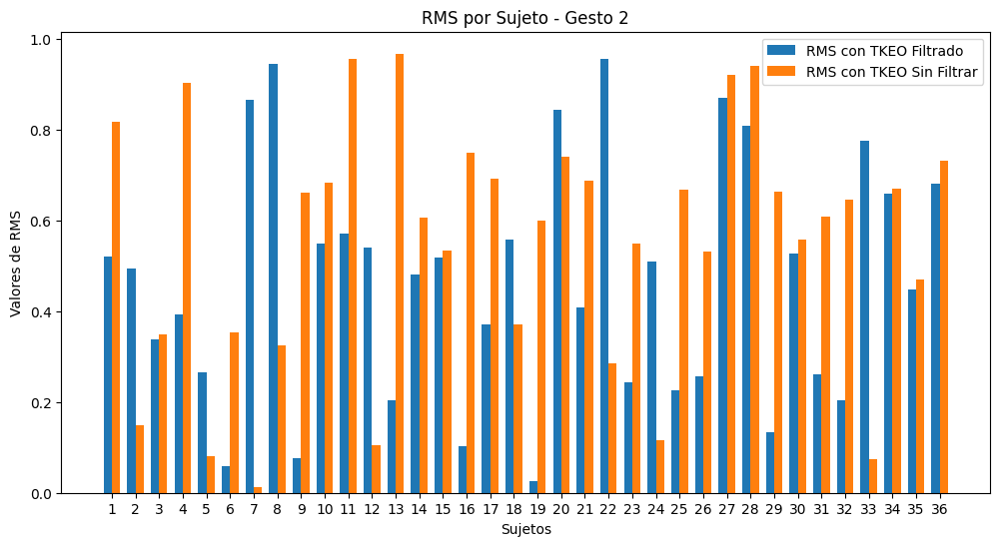

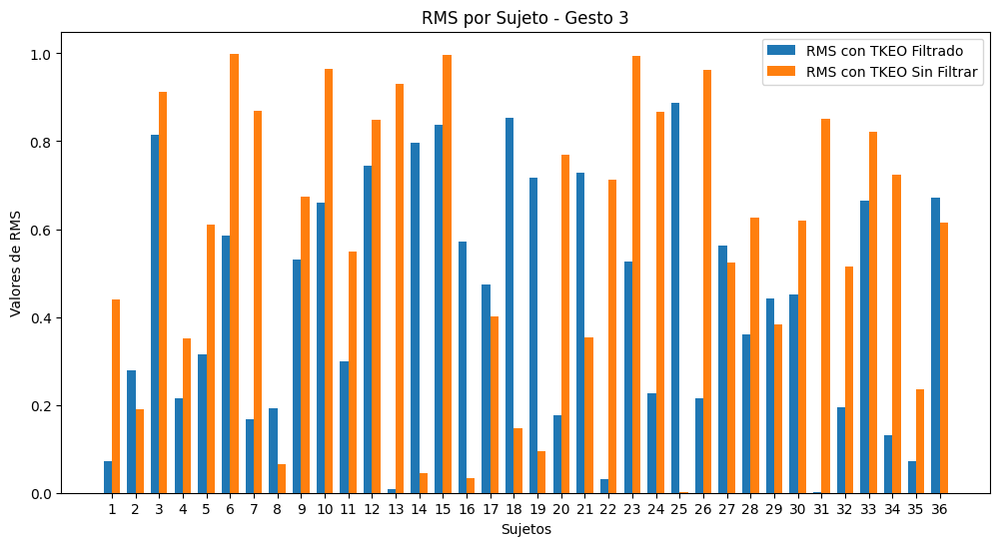

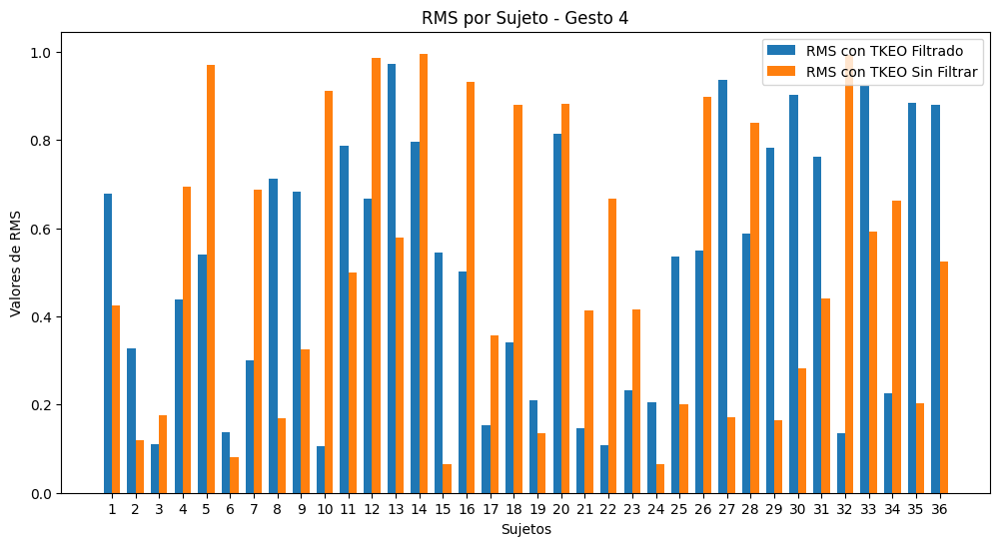

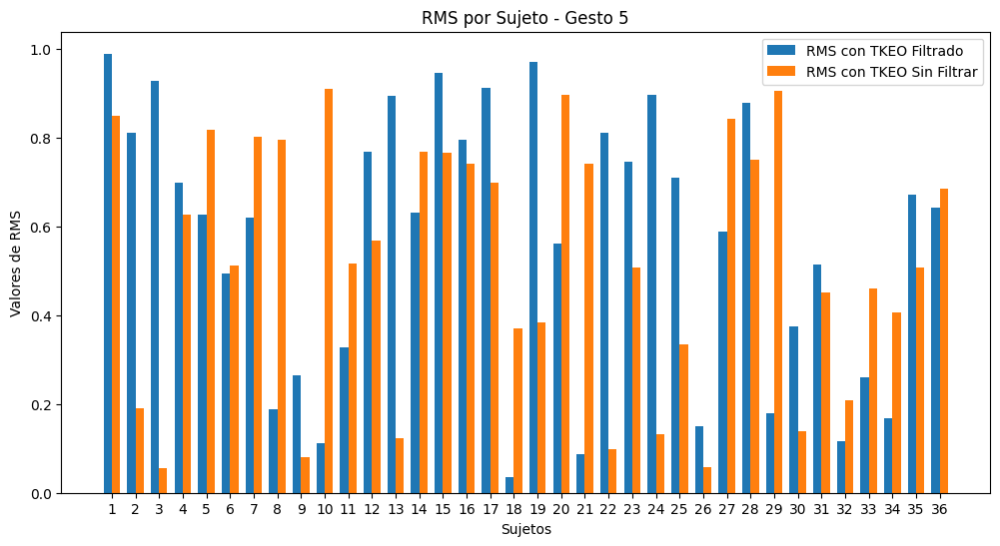

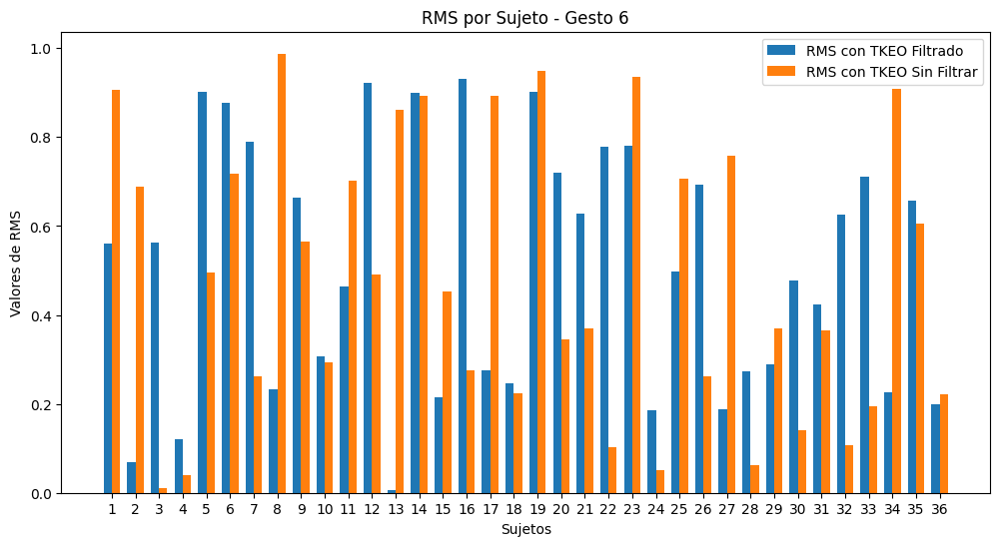

In [ ]:
dataset = pd.read_csv('dataset.csv') # Cargar los datos desde el archivo CSV

# Lista de nombres de características
nombres_caracteristicas = ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC']

# Función para crear los histogramas
def plot_histograma_rms_por_gesto(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'RMS por Sujeto - Gesto {gesto}')
    plt.xlabel('Sujetos')
    plt.ylabel('Valores de RMS')

    sujetos = dataset.loc[dataset['Gesto'] == gesto, 'Sujeto'].unique()
    rms_filtrada = dataset.loc[dataset['Gesto'] == gesto, 'RMS_Filtrado']
    rms_original = dataset.loc[dataset['Gesto'] == gesto, 'RMS_Original']
    bar_width = 0.35
    index = np.arange(len(sujetos))

    plt.bar(index, rms_filtrada, bar_width, label='RMS con TKEO Filtrado')
    plt.bar(index + bar_width, rms_original, bar_width, label='RMS con TKEO Sin Filtrar')
    plt.xticks(index + bar_width / 2, sujetos)
    plt.legend()
    plt.show()

# Generar 7 gráficas, una para cada gesto
for gesto in range(7):
    plot_histograma_rms_por_gesto(gesto)

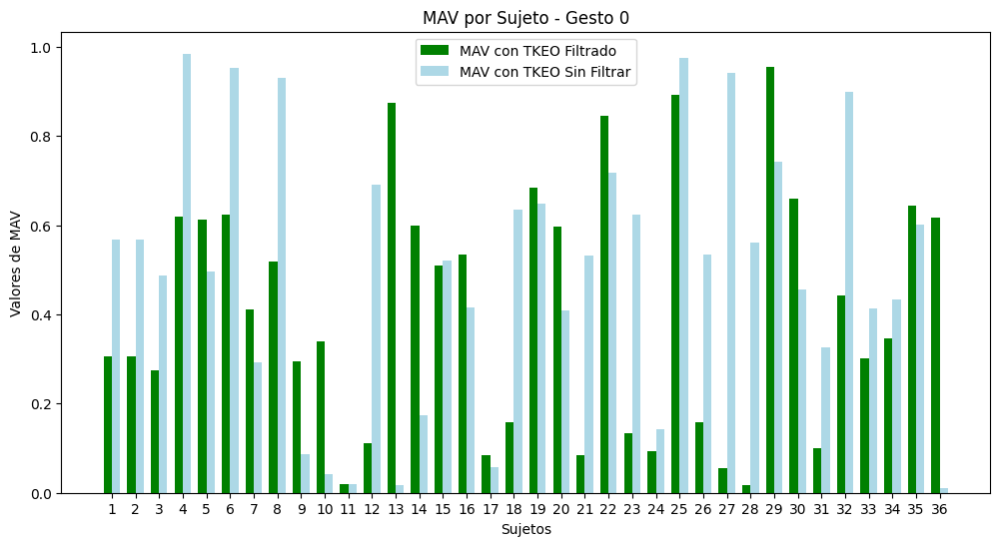

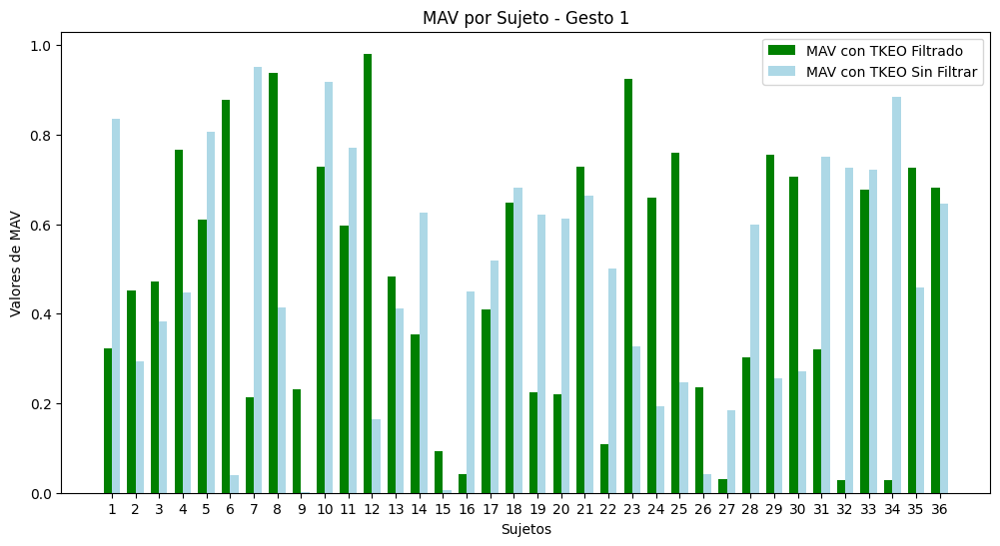

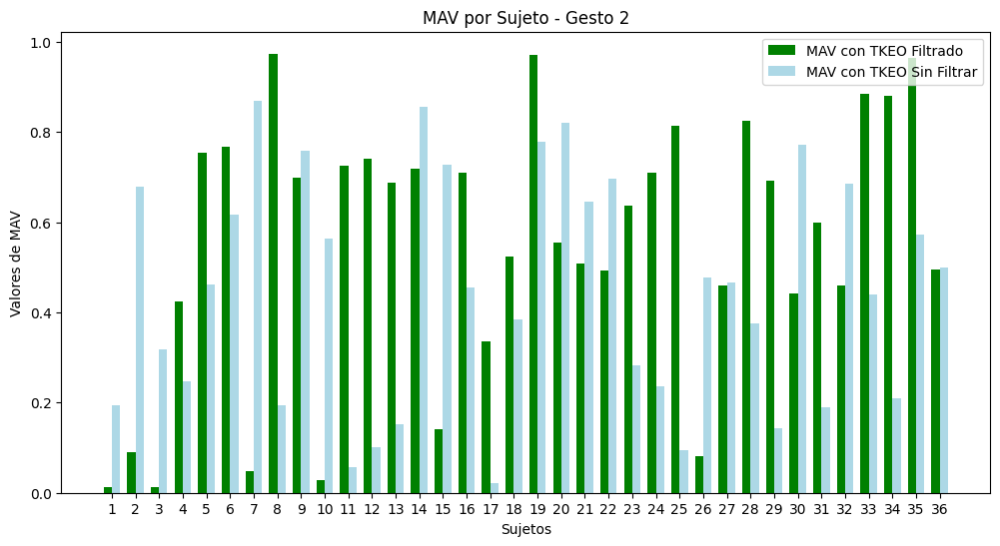

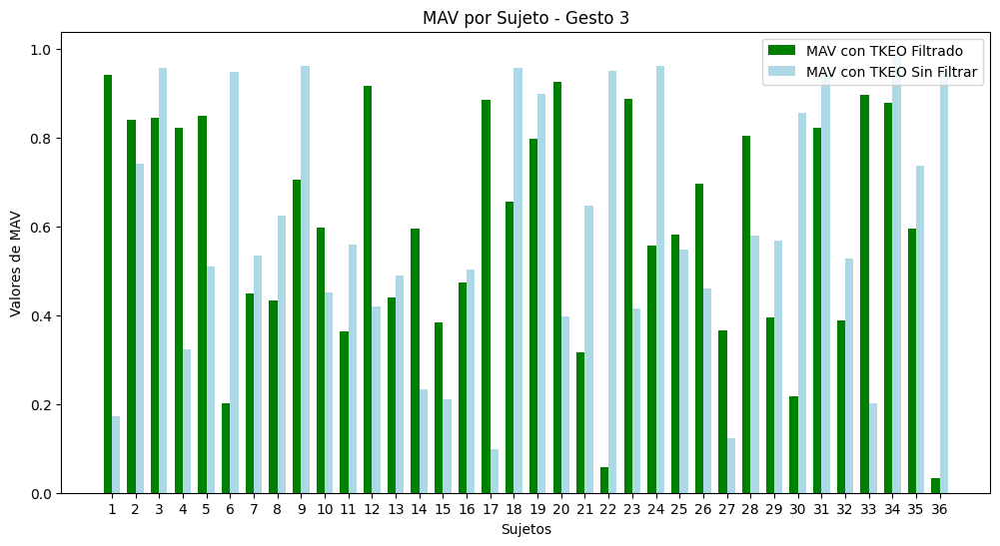

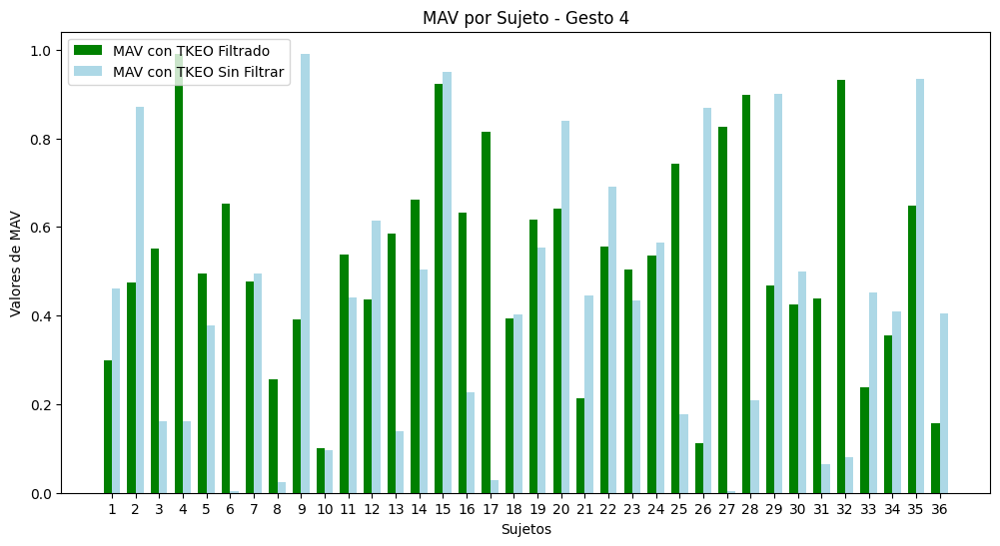

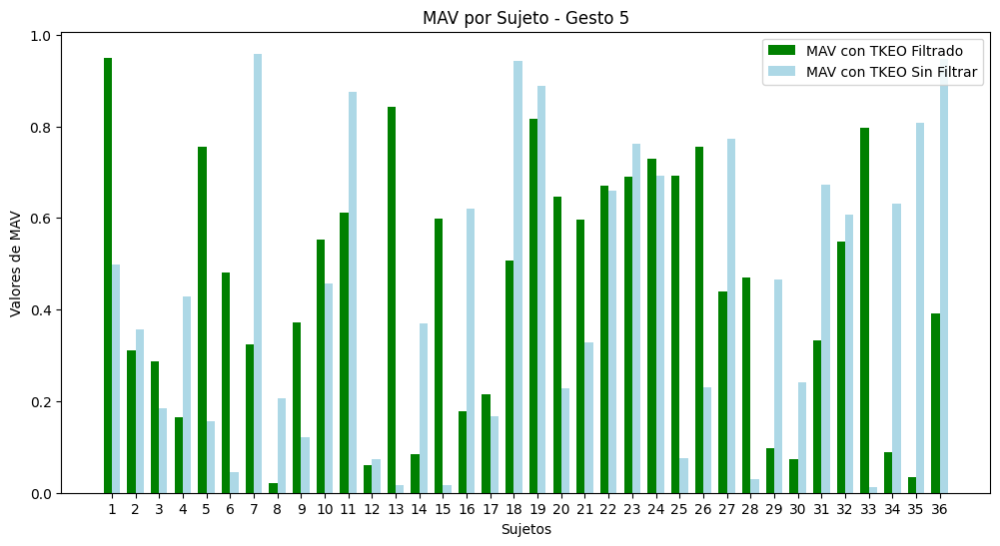

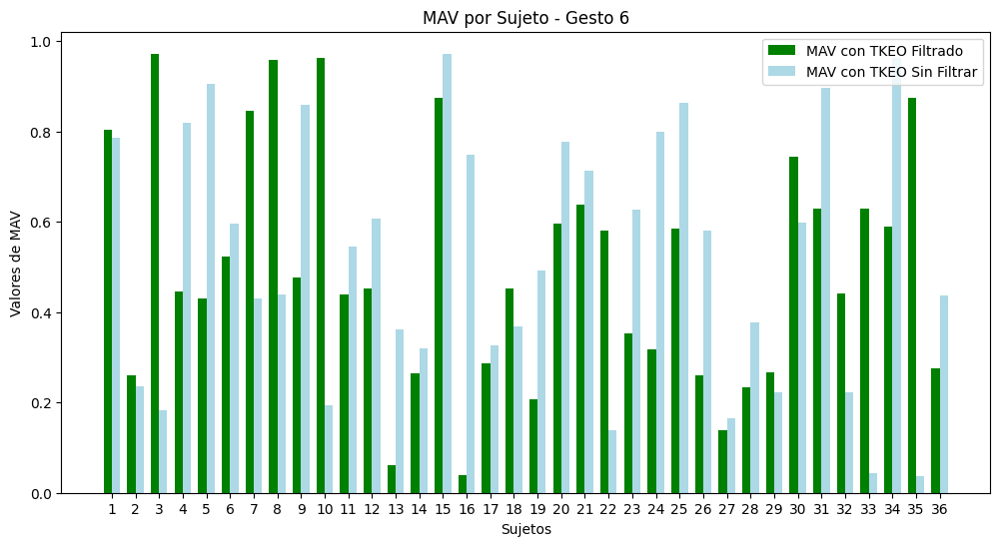

In [ ]:
dataset = pd.read_csv('dataset.csv')

# Lista de nombres de características
nombres_caracteristicas = ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC']

# Función para crear los histogramas
def plot_histograma_mav_por_gesto(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'MAV por Sujeto - Gesto {gesto}')
    plt.xlabel('Sujetos')
    plt.ylabel('Valores de MAV')

    sujetos = dataset.loc[dataset['Gesto'] == gesto, 'Sujeto'].unique()
    mav_filtrada = dataset.loc[dataset['Gesto'] == gesto, 'MAV_Filtrado']
    mav_original = dataset.loc[dataset['Gesto'] == gesto, 'MAV_Original']
    bar_width = 0.35
    index = np.arange(len(sujetos))

    plt.bar(index, mav_filtrada, bar_width, label='MAV con TKEO Filtrado', color='green')  # Color verde
    plt.bar(index + bar_width, mav_original, bar_width, label='MAV con TKEO Sin Filtrar', color='lightblue')  # Color azul claro
    plt.xticks(index + bar_width / 2, sujetos)
    plt.legend()
    plt.show()

# Generar 7 gráficas, una para cada gesto
for gesto in range(7):
    plot_histograma_mav_por_gesto(gesto)

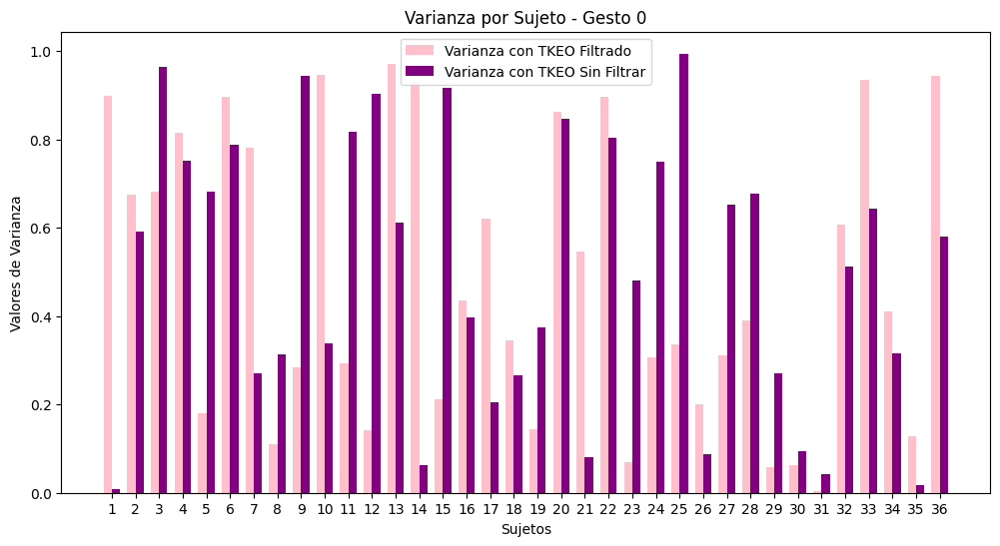

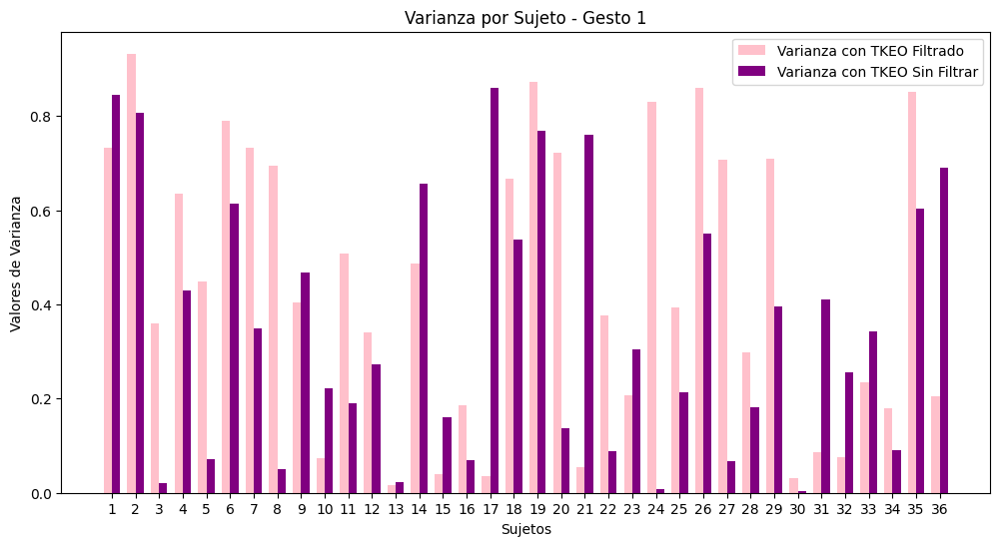

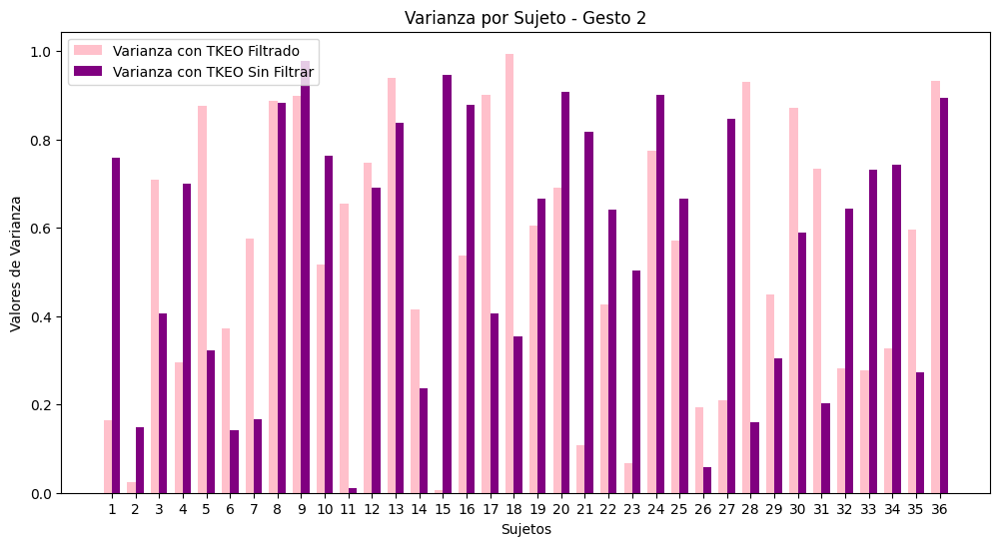

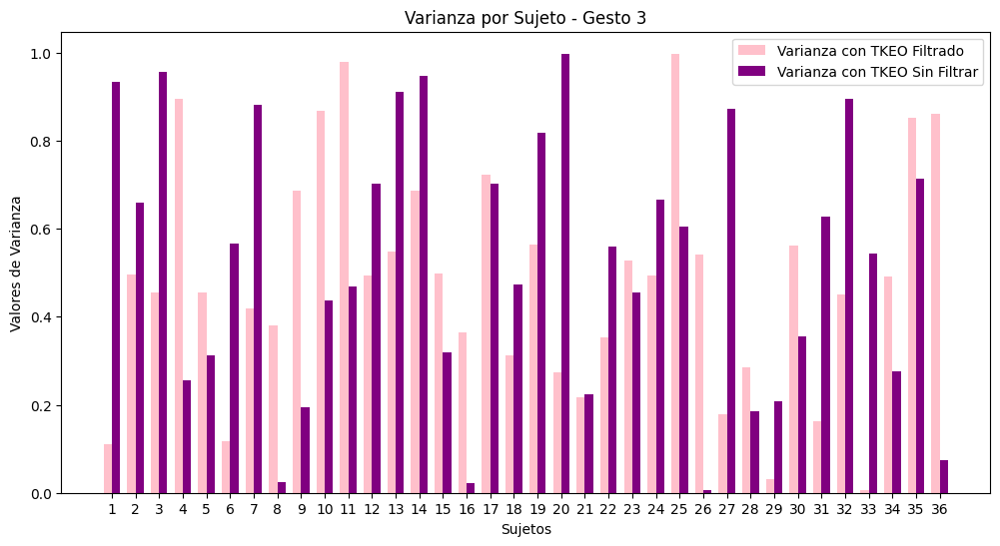

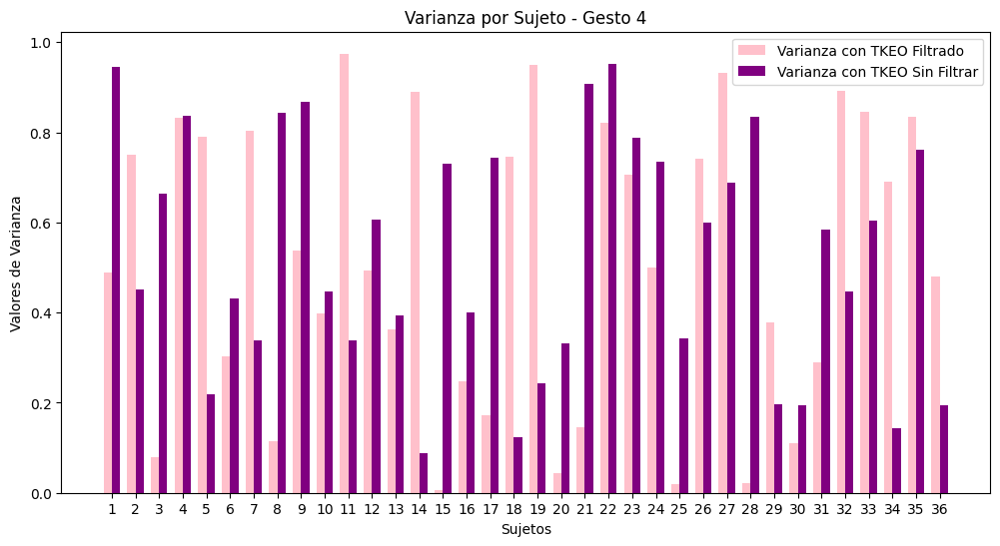

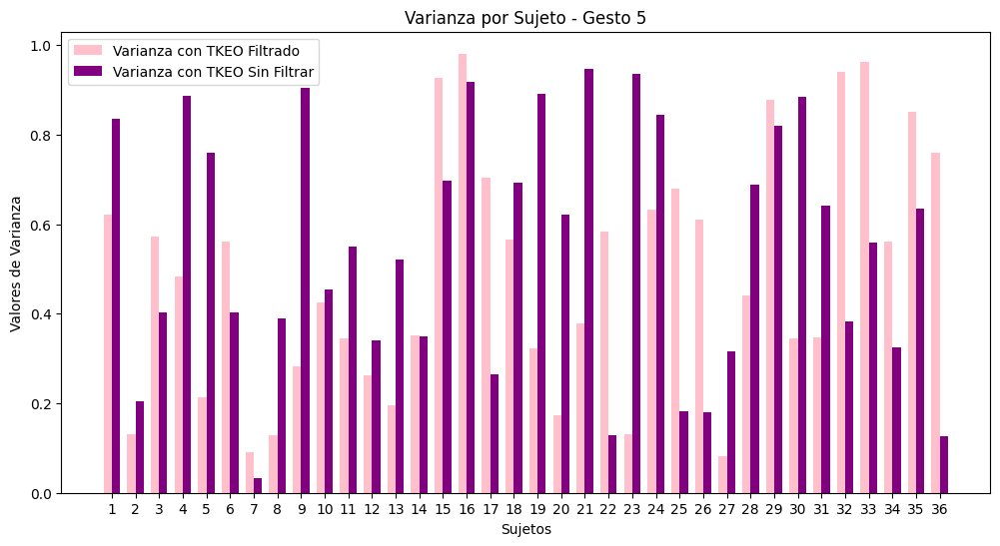

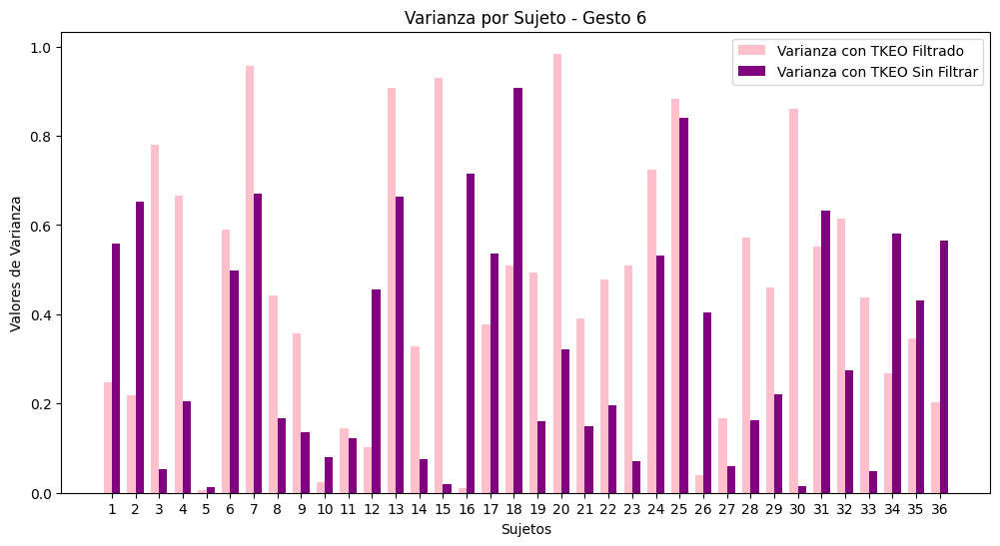

In [ ]:
dataset = pd.read_csv('dataset.csv')

# Lista de nombres de características
nombres_caracteristicas = ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC']

# Función para crear los histogramas
def plot_histograma_varianza_por_gesto(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'Varianza por Sujeto - Gesto {gesto}')
    plt.xlabel('Sujetos')
    plt.ylabel('Valores de Varianza')

    sujetos = dataset.loc[dataset['Gesto'] == gesto, 'Sujeto'].unique()
    varianza_filtrada = dataset.loc[dataset['Gesto'] == gesto, 'Varianza_Filtrado']
    varianza_original = dataset.loc[dataset['Gesto'] == gesto, 'Varianza_Original']

    bar_width = 0.35
    index = np.arange(len(sujetos))

    plt.bar(index, varianza_filtrada, bar_width, label='Varianza con TKEO Filtrado', color='pink')  # Color rosado
    plt.bar(index + bar_width, varianza_original, bar_width, label='Varianza con TKEO Sin Filtrar', color='purple')  # Color morado

    plt.xticks(index + bar_width / 2, sujetos)
    plt.legend()
    plt.show()

# Generar 7 gráficas, una para cada gesto
for gesto in range(7):
    plot_histograma_varianza_por_gesto(gesto)

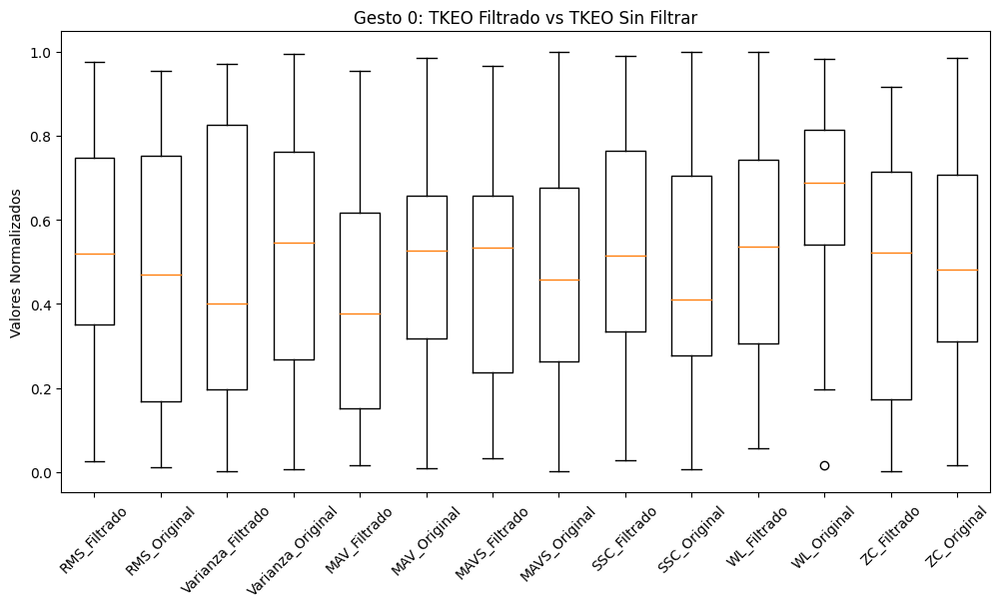

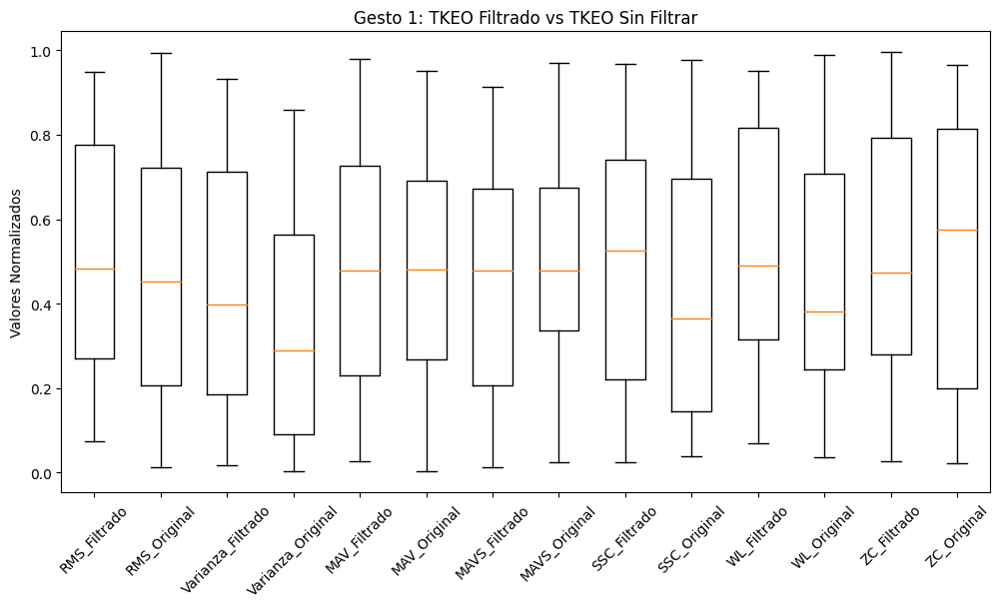

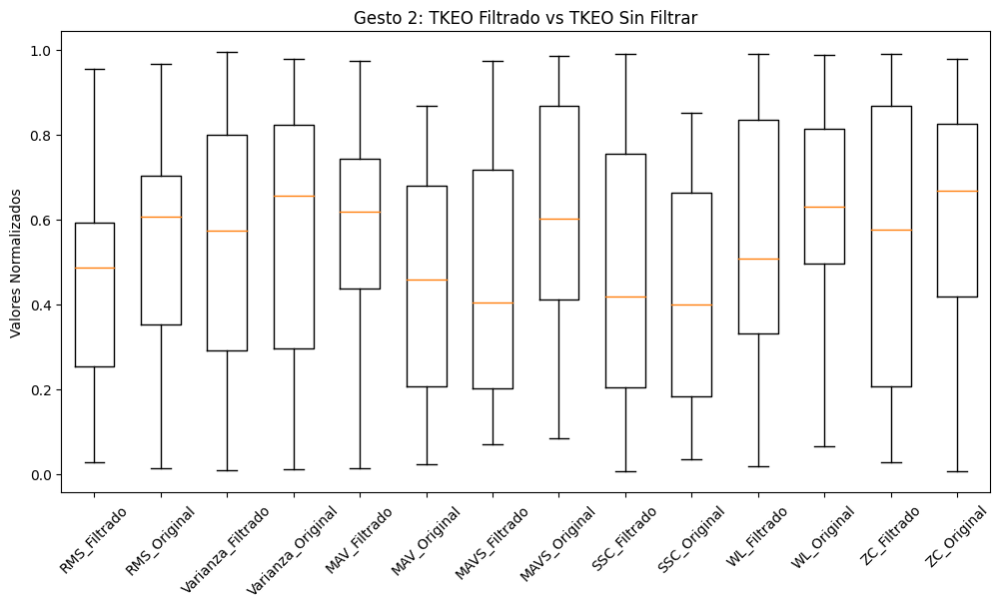

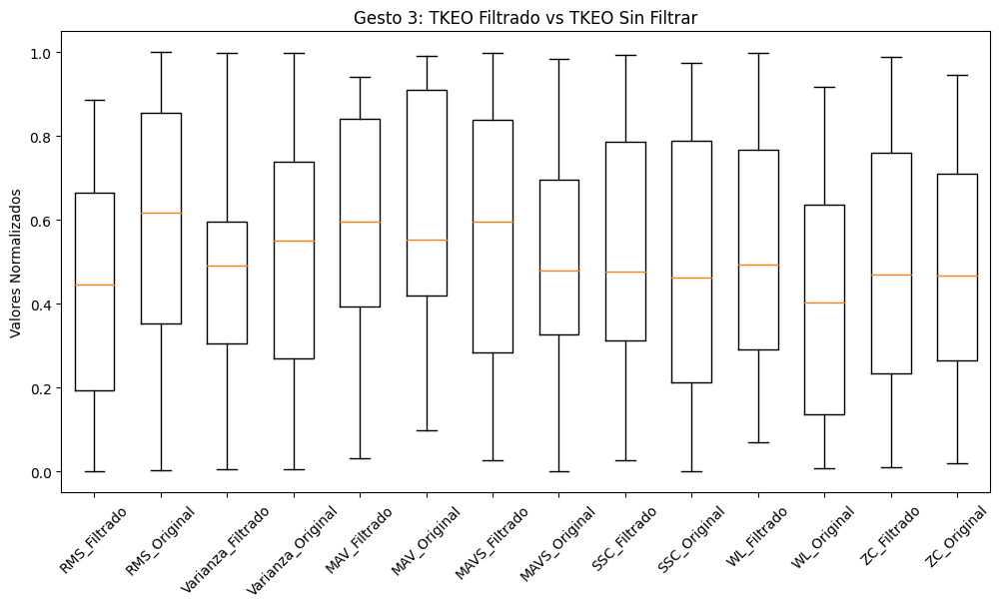

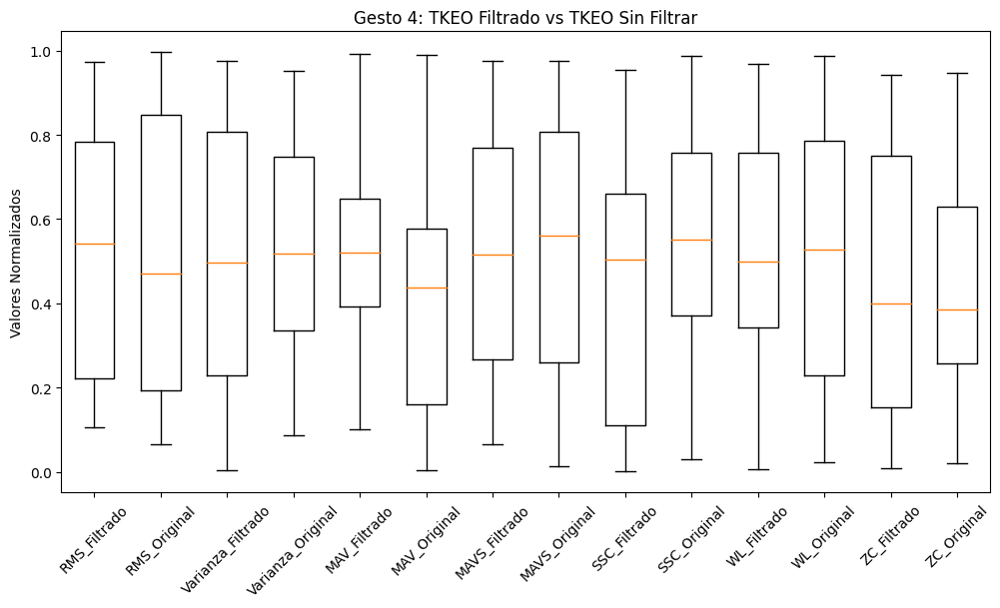

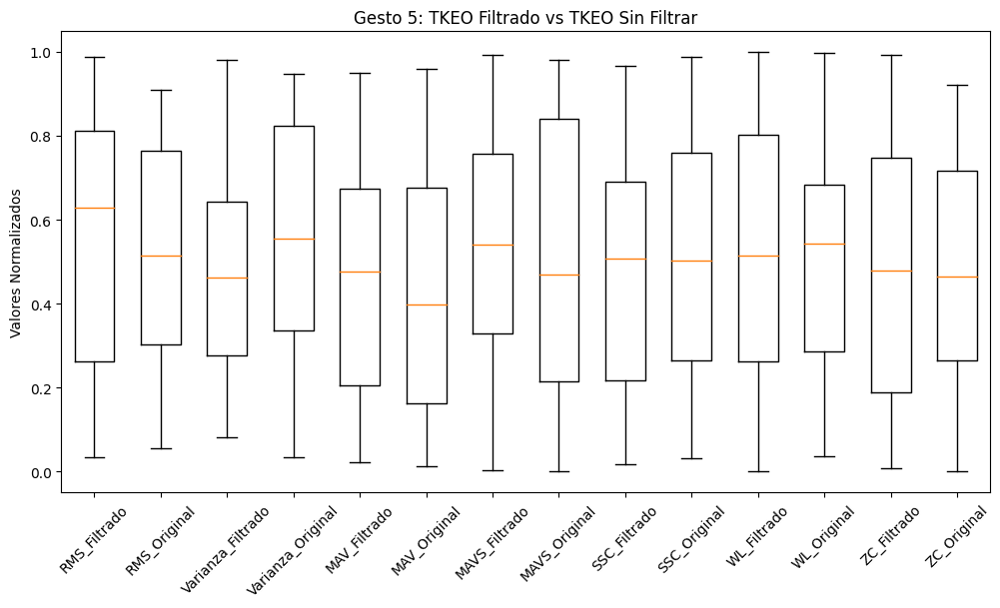

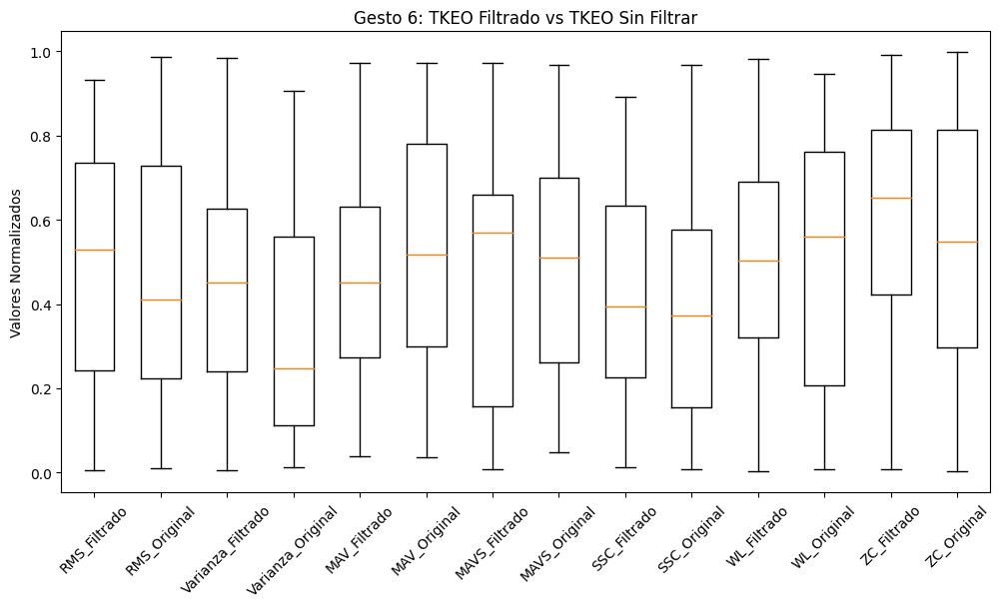

In [ ]:
dataset = pd.read_csv('dataset.csv') # Cargar los datos desde el archivo CSV

#función para generar los boxplots
def plot_boxplot_tkeo_filtered_vs_unfiltered(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'Gesto {gesto}: TKEO Filtrado vs TKEO Sin Filtrar')
    plt.boxplot([dataset.loc[dataset['Gesto'] == gesto, f'{feature}_Filtrado'] for feature in nombres_caracteristicas],
                labels=[f'{feature}_Filtrado' for feature in nombres_caracteristicas],
                positions=np.arange(7)*2,
                widths=0.6)
    plt.boxplot([dataset.loc[dataset['Gesto'] == gesto, f'{feature}_Original'] for feature in nombres_caracteristicas],
                labels=[f'{feature}_Original' for feature in nombres_caracteristicas],
                positions=[x + 1 for x in np.arange(7)*2],
                widths=0.6)
    plt.xticks(rotation=45)
    plt.ylabel('Valores Normalizados')
    plt.show()


nombres_caracteristicas = ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC'] #lista de nombres de características
#graficas para cada gesto
for gesto in range(7):
    plot_boxplot_tkeo_filtered_vs_unfiltered(gesto)

 **E. CODIGO Y ANALISIS DE RESULTADOS DONDE SE DISCUTAN POR LO MENOS TRES DIFERENTES ARQUITECTURAS DE RED Y LAS MATRICES DE CONFUSION OBTENIDAS, VALIDACION CRUZADA, DE UNA RED NEURONAL QUE PERMITA LA CLASIFICACION DE LOS DIFERENTES GESTOS (ETIQUETAS CON LOS DATOS DEL PRIMER PROYECTO)**
 ------


Arquitectura de redes neuronales:

Una **capa** agrupa varias neuronas.
Siempre habrá una capa de entrada y otra de salida.

Podemos tener cero o más capas ocultas en una red neuronal.

El proceso de aprendizaje de una red neuronal se realiza con las capas.

Las neuronas, dentro de cada una de las capas de una red neuronal, realizan la misma función. Simplemente calculan la suma ponderada de entradas y pesos, añaden el sesgo y ejecutan una función de activación.

* Capa de entrada:
El número de neuronas en una capa de entrada depende de la forma de sus datos de entrenamiento.

**número_neuronas = número_características + 1**

Un nodo adicional es para capturar el término de sesgo.

* Capa de salida

La capa de salida es la encargada de producir el resultado final.

Siempre debe haber una capa de salida en una red neuronal.

**¿Cuántas neuronas hay en la capa de salida?**

Si la red neuronal es un regresor, la capa de salida tiene un único nodo.
Si la red neuronal es un clasificador, también tiene un único nodo.
Si utiliza una función de activación probabilística como softmax, la capa de salida tiene un nodo por cada etiqueta de clase del modelo.

* Capa oculta

Las capas ocultas se encuentran entre las capas de entrada y salida.

Puede haber cero o más capas ocultas en una red neuronal.

Normalmente, cada capa oculta contiene el mismo número de neuronas.

Cuanto mayor sea el número de capas ocultas de una red neuronal, más tardará ésta en producir la salida y más complejos serán los problemas que pueda resolver.

El número óptimo de neuronas capas ocultas se puede determinar por:

 **número_neuronas = (muestras de datos comerciales)/(factor*(neuronas_entrada+neuronas_salida))**

El factor se utiliza para evitar el sobreajuste y es un número entre 1-10.

**El número de neuronas ocultas debe estar entre el tamaño de la capa de entrada y el tamaño de la capa de salida.
El número de neuronas ocultas debe ser 2/3 del tamaño de la capa de entrada, más el tamaño de la capa de salida.
El número de neuronas ocultas debe ser inferior al doble del tamaño de la capa de entrada.**



In [ ]:
#Primera estructura:
#Arquitectura 1: Red Neuronal Densa Simple
#Capa de Entrada:
#Neuronas: numero de caracterisitas+1
#Dado que tenemos 8 canales EMG, la capa de entrada tendrá 9 neuronas (8 canales + 1 término de sesgo).
#Capas Ocultas:
#Usaremos 2 capas ocultas con neuronas calculadas basadas en las reglas proporcionadas.
#Capa de Salida:
#Neuronas: 7 (una por cada clase de gesto)
#Función de activación: Softmax

# Step 1 - Loading the Required Libraries and Modules
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from math import sqrt
from sklearn.metrics import r2_score
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.model_selection import learning_curve

# %% Step 2 - Reading the Data and Performing Basic Data Checks
print(dataset.shape)

(252, 16)


In [ ]:
dataset

,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
0,1,0,0.967529,0.899458,0.304973,0.523343,0.692813,0.324923,0.400979,0.206687,0.008105,0.567894,0.294320,0.972277,0.816359,0.140743
1,1,1,0.921889,0.732524,0.323016,0.098101,0.706596,0.951985,0.310474,0.610668,0.845666,0.834849,0.134159,0.695137,0.494052,0.188337
2,1,2,0.520974,0.164108,0.012285,0.202540,0.482288,0.791549,0.910989,0.816286,0.759430,0.193458,0.084487,0.546607,0.381869,0.695984
3,1,3,0.071175,0.110245,0.941730,0.136561,0.608107,0.556841,0.086143,0.440155,0.934270,0.172704,0.409323,0.903561,0.556725,0.181940
4,1,4,0.678026,0.489766,0.299194,0.716261,0.778586,0.444686,0.820892,0.424060,0.945917,0.461837,0.862624,0.397108,0.951605,0.103666
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,36,2,0.680387,0.933362,0.494745,0.691010,0.263344,0.959164,0.751231,0.731703,0.893357,0.499420,0.535775,0.365837,0.827074,0.553241
248,36,3,0.671718,0.860669,0.032151,0.513285,0.935852,0.777769,0.971808,0.614433,0.074441,0.947274,0.297698,0.432402,0.634621,0.889389
249,36,4,0.880725,0.480396,0.157673,0.436517,0.803565,0.491211,0.102678,0.523664,0.195365,0.403943,0.974998,0.058570,0.141351,0.291916
250,36,5,0.641866,0.758722,0.392387,0.543615,0.701433,0.522568,0.056555,0.684505,0.125691,0.947539,0.270518,0.536146,0.639066,0.915092


In [ ]:
dataset.head()

,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
0,1,0,0.967529,0.899458,0.304973,0.523343,0.692813,0.324923,0.400979,0.206687,0.008105,0.567894,0.294320,0.972277,0.816359,0.140743
1,1,1,0.921889,0.732524,0.323016,0.098101,0.706596,0.951985,0.310474,0.610668,0.845666,0.834849,0.134159,0.695137,0.494052,0.188337
2,1,2,0.520974,0.164108,0.012285,0.202540,0.482288,0.791549,0.910989,0.816286,0.759430,0.193458,0.084487,0.546607,0.381869,0.695984
3,1,3,0.071175,0.110245,0.941730,0.136561,0.608107,0.556841,0.086143,0.440155,0.934270,0.172704,0.409323,0.903561,0.556725,0.181940
4,1,4,0.678026,0.489766,0.299194,0.716261,0.778586,0.444686,0.820892,0.424060,0.945917,0.461837,0.862624,0.397108,0.951605,0.103666


In [ ]:
dataset.describe()

,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
count,252.000000,252.00000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000
mean,18.500000,3.00000,0.500512,0.486432,0.502804,0.499778,0.477041,0.524179,0.506100,0.511472,0.478258,0.486160,0.509308,0.470704,0.524940,0.507394
std,10.408968,2.00398,0.278124,0.294357,0.272558,0.289905,0.288809,0.284222,0.307991,0.303440,0.294224,0.287923,0.287596,0.289923,0.283206,0.287923
min,1.000000,0.00000,0.001164,0.002773,0.012285,0.003461,0.000663,0.002065,0.001501,0.002638,0.003596,0.002020,0.000262,0.000206,0.007678,0.000268
25%,9.750000,1.00000,0.234803,0.230353,0.298149,0.235218,0.221154,0.296652,0.225378,0.219149,0.205606,0.227247,0.271796,0.194312,0.286819,0.266432
50%,18.500000,3.00000,0.519900,0.481427,0.508455,0.523554,0.480579,0.506117,0.509061,0.524332,0.462113,0.482164,0.491401,0.424806,0.556507,0.488118
75%,27.250000,5.00000,0.763343,0.733047,0.709173,0.760122,0.739934,0.779057,0.771791,0.760397,0.730077,0.714553,0.741137,0.736167,0.761568,0.760811
max,36.000000,6.00000,0.988587,0.997151,0.990999,0.997324,0.992852,0.998597,0.995422,0.999362,0.997718,0.990221,0.998327,0.998368,0.998270,0.997442


In [ ]:
#Creación de matrices para las características y la variable de respuesta
target_column = ['Gesto']
predictors = list(set(list(dataset.columns))-set(target_column)-set(['Sujeto'])-set(['ZC_Original'])-set(['SSC_Original'])-set(['Varianza_Original'])-set(['MAVS_Original'])-set(['MAV_Original'])-set(['RMS_Original'])-set(['WL_Original']))
print(predictors)

dataset[predictors] = dataset[predictors]/dataset[predictors].max() #variables normalizadas
dataset.describe()

['SSC_Filtrado', 'MAV_Filtrado', 'Varianza_Filtrado', 'MAVS_Filtrado', 'WL_Filtrado', 'ZC_Filtrado', 'RMS_Filtrado']


,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
count,252.000000,252.00000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000,252.000000
mean,18.500000,3.00000,0.506290,0.487822,0.507371,0.501119,0.480476,0.524916,0.508428,0.511472,0.478258,0.486160,0.509308,0.470704,0.524940,0.507394
std,10.408968,2.00398,0.281335,0.295198,0.275034,0.290683,0.290888,0.284621,0.309407,0.303440,0.294224,0.287923,0.287596,0.289923,0.283206,0.287923
min,1.000000,0.00000,0.001178,0.002781,0.012396,0.003470,0.000668,0.002068,0.001508,0.002638,0.003596,0.002020,0.000262,0.000206,0.007678,0.000268
25%,9.750000,1.00000,0.237513,0.231011,0.300857,0.235849,0.222746,0.297068,0.226414,0.219149,0.205606,0.227247,0.271796,0.194312,0.286819,0.266432
50%,18.500000,3.00000,0.525902,0.482802,0.513073,0.524959,0.484039,0.506828,0.511402,0.524332,0.462113,0.482164,0.491401,0.424806,0.556507,0.488118
75%,27.250000,5.00000,0.772156,0.735141,0.715614,0.762161,0.745261,0.780151,0.775341,0.760397,0.730077,0.714553,0.741137,0.736167,0.761568,0.760811
max,36.000000,6.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.999362,0.997718,0.990221,0.998327,0.998368,0.998270,0.997442


In [ ]:
#creación de los conjuntos de datos de entrenamiento y de prueba
X = dataset[predictors].values
y = dataset[target_column].values

#se utiliza la misma semilla para particionar y obtener los mismos resultados
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=40)
y_test = np.squeeze(y_test)
y_train = np.squeeze(y_train)

#Se muestra el tamaño de los datos
print(f' Tamaño de las caracteristicas los datos de entrenamiento: {X_train.shape}')
print(f' Tamaño de la salida de los datos de entrenamiento: {y_train.shape}')

print(f' Tamaño de las caracteristicas los datos de prueba: {X_test.shape}')
print(f' Tamaño de la salida de los datos de prueba: {y_test.shape}')

 Tamaño de las caracteristicas los datos de entrenamiento: (176, 7)
 Tamaño de la salida de los datos de entrenamiento: (176,)
 Tamaño de las caracteristicas los datos de prueba: (76, 7)
 Tamaño de la salida de los datos de prueba: (76,)


*el codigo hasta aqui prepara los datos y configurando el entorno para entrenar y evaluar un modelo de red neuronal densa (también conocida como perceptrón multicapa o MLP) con el fin de realizar la tarea de clasificación de gestos utilizando las señales de EMG. primero importamos las librerías y módulos necesarios de scikit-learn para construir, entrenar y evaluar el modelo de red neuronal, luego leemos el conjunto de datos desde un archivo CSV, se selecciona las características (predictores) y la variable objetivo (Gesto) del conjunto de datos, se normaliza las características para que tengan una escala similar, se divide el conjunto de datos en conjuntos de entrenamiento y prueba, utilizando una semilla específica para obtener resultados reproducibles y por ultimo queremos mostrar la forma y tamaño de los conjuntos de entrenamiento y prueba para verificar que los datos se han cargado correctamente.*

**Número de neuronas de entrada:**

Número de neuronas = número de caracteristicas + 1

* Número de caracteristicas : 7

Número de neuronas = 8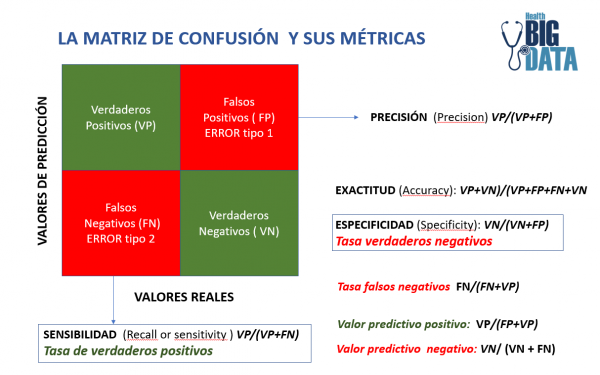

**Número de neuronas en la capa de salida:**

La capa de salida es la responsable de producir el resultado final. Se considera una capa de salida en una red neuronal
neural.

**Número optimo de neuronas ocultas:**

El número de neuronas ocultas debe estar entre el tamaño de la capa de entrada y el tamaño de la capa de salida.
El número de neuronas ocultas debe ser 2/3 del tamaño de la capa de entrada, más el tamaño de la capa de salida.
El número de neuronas ocultas debe ser inferior a dos veces el tamaño de la capa de entrada.

In [ ]:
#Código de la matriz de confusión
from itertools import product
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    fig=plt.figure()
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

**Primera arquitectura**
--
'lbfgs' puede converger más rápido y funcionar mejor

*el codigo está implementando la primera arquitectura de red neuronal propuesta, la arquitectura definida consiste en una capa de entrada cuyo tamaño depende del número de características, tres capas ocultas con 8 neuronas cada una y una función de activación ReLU, y una capa de salida con 7 neuronas, una por cada clase de gesto, y una función de activación Softmax para obtener probabilidades de clasificación, se entrena el modelo utilizando los datos de entrenamiento (X_train, y_train) y se realizan predicciones tanto en los datos de entrenamiento como en los datos de prueba (X_test, y_test), se busca evalúar el rendimiento del modelo calculando la matriz de confusión y el informe de clasificación para los datos de entrenamiento y prueba. La matriz de confusión muestra la distribución de las predicciones correctas e incorrectas para cada clase, mientras que el informe de clasificación proporciona métricas como precisión, recall, f1-score y soporte para cada clase.*

In [ ]:
#Three hidden layer each layer with eigth neurons
mlp = MLPClassifier(hidden_layer_sizes=(8,8,8), activation='relu', solver='adam', max_iter=25000)
print(mlp)
print('' )

#Se entrena el modelo y se realizan las predicciones
mlp.fit(X_train,y_train)

predict_train = mlp.predict(X_train)
print(predict_train)
predict_test = mlp.predict(X_test)
print(predict_test)

MLPClassifier(hidden_layer_sizes=(8, 8, 8), max_iter=25000)

[0 6 6 3 5 1 6 0 3 0 2 3 0 6 5 3 5 2 3 4 2 0 1 5 6 3 6 0 6 6 5 3 6 6 0 3 0
 2 3 1 4 3 2 6 6 0 6 3 2 5 0 6 6 6 6 3 2 3 5 1 2 5 3 2 2 6 0 3 6 5 1 3 6 1
 6 0 6 2 6 4 6 2 2 4 0 2 3 0 4 6 1 0 6 6 5 0 5 4 1 5 3 0 1 2 0 5 6 6 3 6 6
 0 3 3 5 4 1 6 6 2 0 3 0 4 3 2 0 6 6 0 6 3 6 1 3 0 3 3 2 3 0 4 4 5 1 6 6 6
 4 0 2 5 3 3 3 2 0 0 3 2 6 0 6 1 5 5 0 6 5 1 1 6 6 5 2 0]
[4 2 1 3 3 3 0 2 6 0 5 6 6 6 2 2 0 0 3 0 2 2 3 6 5 6 1 3 0 3 3 3 6 2 5 6 1
 2 6 4 5 6 3 2 6 6 2 5 3 1 2 3 0 0 0 6 6 3 1 6 6 2 2 0 0 4 5 6 2 0 3 5 0 6
 3 0]


In [ ]:
#%% Results, esta matriz debe de dar enormeeeeee
print(confusion_matrix(y_train,predict_train))
print(' ')

#importar las funciones necesarias
from sklearn.metrics import classification_report
#especificar las etiquetas de las clases directamente
labels = ['0','1', '2', '3', '4','5','6']
#iprimir el reporte de clasificación
print(classification_report(y_train, predict_train, labels=labels))

[[20  0  3  0  0  2  1]
 [ 2  5  3  3  3  1  8]
 [ 4  1 11  2  1  1  2]
 [ 1  1  1 19  2  2  3]
 [ 0  6  3  3  3  3  8]
 [ 3  0  0  3  2 10  4]
 [ 1  2  1  2  0  1 19]]
 
              precision    recall  f1-score   support

           0       0.65      0.77      0.70        26
           1       0.33      0.20      0.25        25
           2       0.50      0.50      0.50        22
           3       0.59      0.66      0.62        29
           4       0.27      0.12      0.16        26
           5       0.50      0.45      0.48        22
           6       0.42      0.73      0.54        26

   micro avg       0.49      0.49      0.49       176
   macro avg       0.47      0.49      0.46       176
weighted avg       0.47      0.49      0.47       176



In [ ]:
print(confusion_matrix(y_test,predict_test))
print('')
print(classification_report(y_test,predict_test,labels=labels))

[[2 0 3 2 0 0 3]
 [2 1 3 2 0 2 1]
 [3 1 1 4 0 0 5]
 [1 0 0 4 0 0 2]
 [1 1 2 2 1 3 0]
 [4 2 3 0 0 0 5]
 [1 0 2 1 2 2 2]]

              precision    recall  f1-score   support

           0       0.14      0.20      0.17        10
           1       0.20      0.09      0.13        11
           2       0.07      0.07      0.07        14
           3       0.27      0.57      0.36         7
           4       0.33      0.10      0.15        10
           5       0.00      0.00      0.00        14
           6       0.11      0.20      0.14        10

   micro avg       0.14      0.14      0.14        76
   macro avg       0.16      0.18      0.15        76
weighted avg       0.14      0.14      0.13        76



Confusion matrix, without normalization
[[20  0  3  0  0  2  1]
 [ 2  5  3  3  3  1  8]
 [ 4  1 11  2  1  1  2]
 [ 1  1  1 19  2  2  3]
 [ 0  6  3  3  3  3  8]
 [ 3  0  0  3  2 10  4]
 [ 1  2  1  2  0  1 19]]


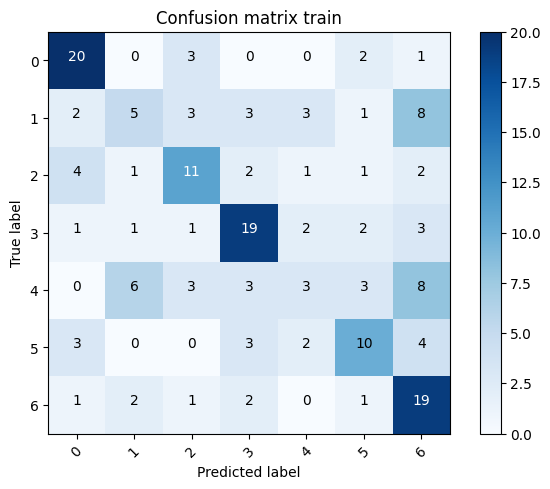

In [ ]:
mc_train = confusion_matrix(y_train,predict_train)
plot_confusion_matrix(mc_train, classes=labels,
                      title='Confusion matrix train')

Confusion matrix, without normalization
[[2 0 3 2 0 0 3]
 [2 1 3 2 0 2 1]
 [3 1 1 4 0 0 5]
 [1 0 0 4 0 0 2]
 [1 1 2 2 1 3 0]
 [4 2 3 0 0 0 5]
 [1 0 2 1 2 2 2]]


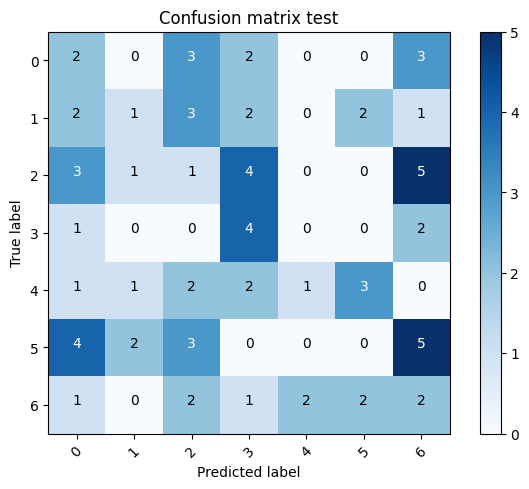

In [ ]:
#Matriz de confusión sujetos de entrenamiento
mc_test = confusion_matrix(y_test,predict_test)
plot_confusion_matrix(mc_test, classes=labels,
                      title='Confusion matrix test')

**Análisis**
---

La matriz de confusión tiene la siguiente forma:

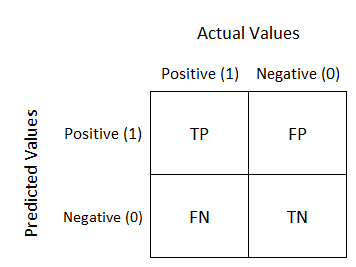



La matriz de confusión proporciona una visión detallada del rendimiento de un modelo de clasificación, permitiendo entender de una manera más visual qué tan bien modelo predice cada clase, en este caso, las clases son los gestos de la mano.
En las matrices de confusión tan grandes como la presentada en el trabajo, se tiene que las entradas diagonales representan los casos en los que la etiqueta verdadera coincide con la etiqueta predicha. Es decir, para la clase 0, posición [0][0] en la matriz, el modelo predijo correctamente 3 casos.
Las entradas fuera de la diagonal indican errores de clasificación. Es decir, la clase 0 fue predicha como clase 1 en 2 ocasiones.

Por otro lado, la clase 1 tiene varios errores donde es predicha como clase 0, 1, 2, 5 y 6 y fue predicha correctamente 0 veces.

La clase 4 tiene errores al ser predicha como clase 0 y clase 6 y fue predica correctamente 0 veces.

La variabilidad en la matriz sugiere que el modelo puede tener dificultades para distinguir entre ciertas clases específicas. Por ejemplo, las clases 1 y 3 parecen tener predicciones distribuidas en múltiples otras clases.

Para mejorar el modelo, se podrían considerar estrategias como el ajuste de hiperparámetros, el uso de más datos de entrenamiento.


In [ ]:
#Curva de aprendizaje
def plot_learning_curve(
    estimator,
    title,
    X,
    y,
    axes=None,
    ylim=None,
    cv=None,
    n_jobs=None,
    scoring=None,
    train_sizes=np.linspace(0.1, 1.0, 5),
):
    #Se estable los axes
    if axes is None:
        _, axes = plt.subplots(1, figsize=(10, 10))


    axes.set_title(title)
    #Se establece y lim
    if ylim is not None:
        axes.set_ylim(*ylim)
    axes.set_xlabel("Training examples")
    axes.set_ylabel("Score")

    #Se genera la curva de aprendizaje
    train_sizes, train_scores, test_scores, fit_times, _ = learning_curve(
        estimator,
        X,
        y,
        scoring=scoring,
        cv=cv,
        n_jobs=n_jobs,
        train_sizes=train_sizes,
        return_times=True,
    )
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Grafico de la curva de aprendizaje
    axes.grid()
    axes.fill_between(
        train_sizes,
        train_scores_mean - train_scores_std,
        train_scores_mean + train_scores_std,
        alpha=0.1,
        color="r",
    )
    axes.fill_between(
        train_sizes,
        test_scores_mean - test_scores_std,
        test_scores_mean + test_scores_std,
        alpha=0.1,
        color="g",
    )
    axes.plot(
        train_sizes, train_scores_mean, "o-", color="r", label="Training score"
    )
    axes.plot(
        train_sizes, test_scores_mean, "o-", color="g", label="Cross-validation score"
    )
    axes.legend(loc="best")

    #Se retorna el grafico de la curva de aprendizaje
    return plt

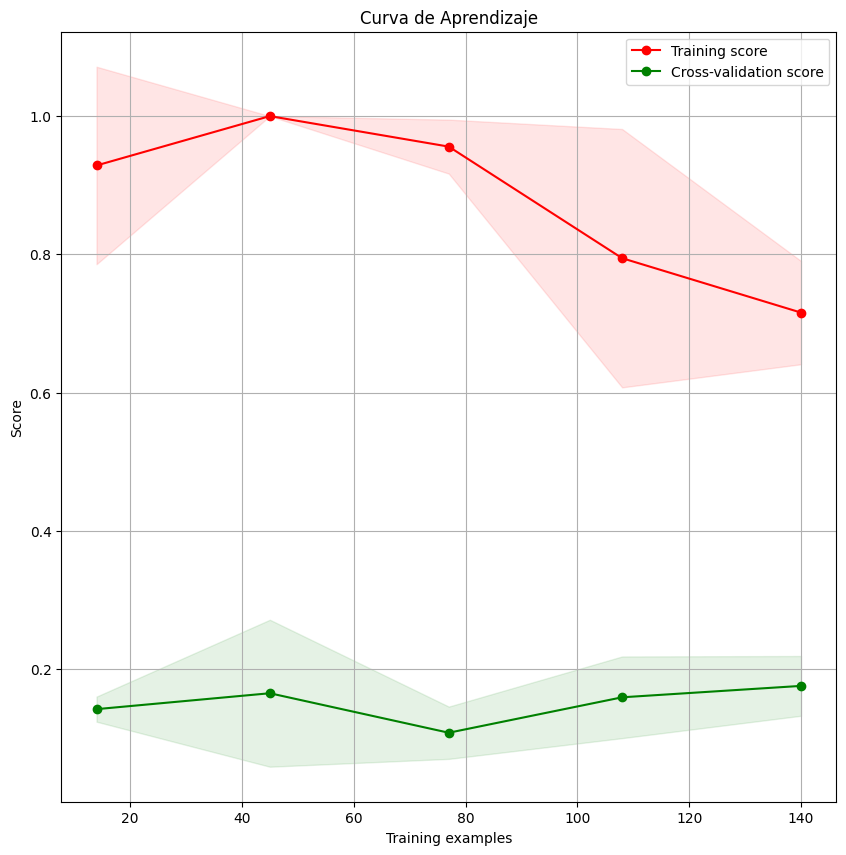

In [ ]:
#Se genera la curva de aprendizaje
plot_learning_curve(estimator=mlp,
                    X=X_train,
                    y=y_train,
                    title='Curva de Aprendizaje')
plt.show()

# Análisis

La curva de aprendizaje determina las puntuaciones de entrenamiento y prueba de validación cruzada para distintos tamaños de conjuntos de entrenamiento [1].

En la curva de aprendizaje se pueden detallar dos líneas, la línea roja representa el puntaje de entrenamiento y la línea verde representa el puntaje de validación cruzada a medida que se incrementa el número de ejemplos de entrenamiento, en la gráfica se puede observar que al inicio, con pocos ejemplos de entrenamiento, el puntaje de entrenamiento es muy alto (cercano a 1.0), lo que indica que el modelo está sobreajustado a los datos de entrenamiento y el puntaje de validación cruzada es muy bajo (alrededor de 0.2), lo que indica que el modelo generaliza o prodice mal a datos no vistos.

Por otro lado, a medida que se aumentan los ejemplos de entrenamiento, el puntaje de entrenamiento disminuye, esto es esperado porque el modelo tiene que ajustar a más datos, reduciendo el sobreajuste, el puntaje de validación cruzada muestra una ligera tendencia ascendente, lo cual es una señal positiva debido a que indica una mejora en la capacidad de generalización del modelo.

El puntaje de entrenamiento se estabiliza alrededor de 0.7, mientras que el de validación cruzada lo hace alrededor de 0.2 esto indica que el modelo está limitado en su capacidad de mejorar la precisión en datos no vistos, posiblemente debido a su complejidad o a la naturaleza de los datos.

**Segunda Arquitectura**
-----

In [ ]:
mlp_2 = MLPClassifier((16,16,16), #Tamaño de la red
                      max_iter=20000, #Número de iteraciones
                      activation='relu', # Función de activación
                      solver='adam', # optimizador de función de perdida
                      alpha= 0.0001,
                      learning_rate='adaptive', # Cambios en la tasa de aprendizaje
                      random_state=1,
                      early_stopping=True,
                      validation_fraction=0.1,
                      n_iter_no_change=10) #Evitar sobre entrenamiento en la convergencia del optimizador

In [ ]:
mlp_2.fit(X_train,y_train)

predict_train = mlp_2.predict(X_train)
print(predict_train)
predict_test = mlp_2.predict(X_test)
print(predict_test)

[5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 2
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5]
[5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 2 5 5 5 5 5
 5 5]


In [ ]:
#%% Results, esta matriz debe de dar enormeeeeee
print(confusion_matrix(y_train,predict_train))

[[ 0  0  0  0  0 26  0]
 [ 0  0  0  0  0 25  0]
 [ 0  0  0  0  0 22  0]
 [ 0  0  0  0  0 29  0]
 [ 0  0  0  0  0 26  0]
 [ 0  0  0  0  0 22  0]
 [ 0  0  1  0  0 25  0]]


In [ ]:
#importar las funciones necesarias
from sklearn.metrics import classification_report

#especificar las etiquetas de las clases directamente
labels = ['0','1', '2', '3', '4','5','6']
#imprimir el reporte de clasificación
print(classification_report(y_train, predict_train, labels=labels))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        26
           1       0.00      0.00      0.00        25
           2       0.00      0.00      0.00        22
           3       0.00      0.00      0.00        29
           4       0.00      0.00      0.00        26
           5       0.13      1.00      0.22        22
           6       0.00      0.00      0.00        26

   micro avg       0.12      0.12      0.12       176
   macro avg       0.02      0.14      0.03       176
weighted avg       0.02      0.12      0.03       176



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
print(confusion_matrix(y_test,predict_test))

[[ 0  0  0  0  0 10  0]
 [ 0  0  0  0  0 11  0]
 [ 0  0  1  0  0 13  0]
 [ 0  0  0  0  0  7  0]
 [ 0  0  0  0  0 10  0]
 [ 0  0  0  0  0 14  0]
 [ 0  0  0  0  0 10  0]]


In [ ]:
print(classification_report(y_test,predict_test,labels=labels))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        10
           1       0.00      0.00      0.00        11
           2       1.00      0.07      0.13        14
           3       0.00      0.00      0.00         7
           4       0.00      0.00      0.00        10
           5       0.19      1.00      0.31        14
           6       0.00      0.00      0.00        10

   micro avg       0.20      0.20      0.20        76
   macro avg       0.17      0.15      0.06        76
weighted avg       0.22      0.20      0.08        76



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Confusion matrix, without normalization
[[ 0  0  0  0  0 26  0]
 [ 0  0  0  0  0 25  0]
 [ 0  0  0  0  0 22  0]
 [ 0  0  0  0  0 29  0]
 [ 0  0  0  0  0 26  0]
 [ 0  0  0  0  0 22  0]
 [ 0  0  1  0  0 25  0]]


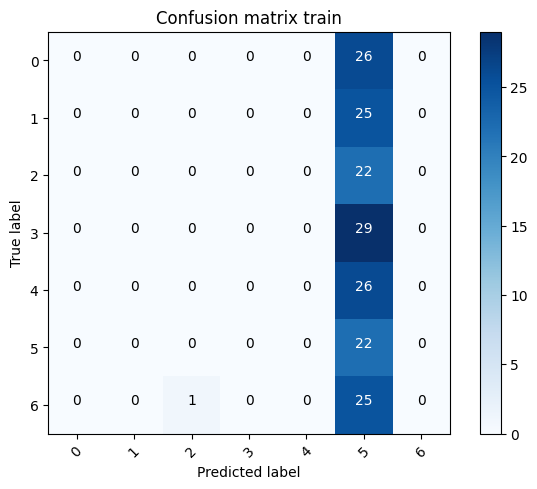

In [ ]:
mc_train = confusion_matrix(y_train,predict_train)
plot_confusion_matrix(mc_train, classes=labels,
                      title='Confusion matrix train')

Confusion matrix, without normalization
[[ 0  0  0  0  0 10  0]
 [ 0  0  0  0  0 11  0]
 [ 0  0  1  0  0 13  0]
 [ 0  0  0  0  0  7  0]
 [ 0  0  0  0  0 10  0]
 [ 0  0  0  0  0 14  0]
 [ 0  0  0  0  0 10  0]]


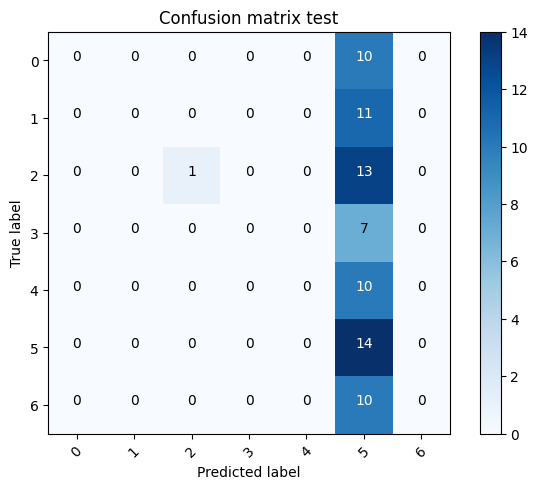

In [ ]:
mc_test = confusion_matrix(y_test,predict_test)
plot_confusion_matrix(mc_test, classes=labels,
                      title='Confusion matrix test')

*La matriz de confusión proporciona información sobre el rendimiento del modelo y puede ayudar a identificar áreas de mejora, como clases con altos índices de clasificación errónea o pares específicos de clases que se confunden con frecuencia, la normalización de la matriz de confusión (dividiendo cada valor por el total de instancias de la clase verdadera correspondiente) puede proporcionar una mejor comprensión del rendimiento relativo de cada clase, especialmente cuando se trata de conjuntos de datos desequilibrados.*

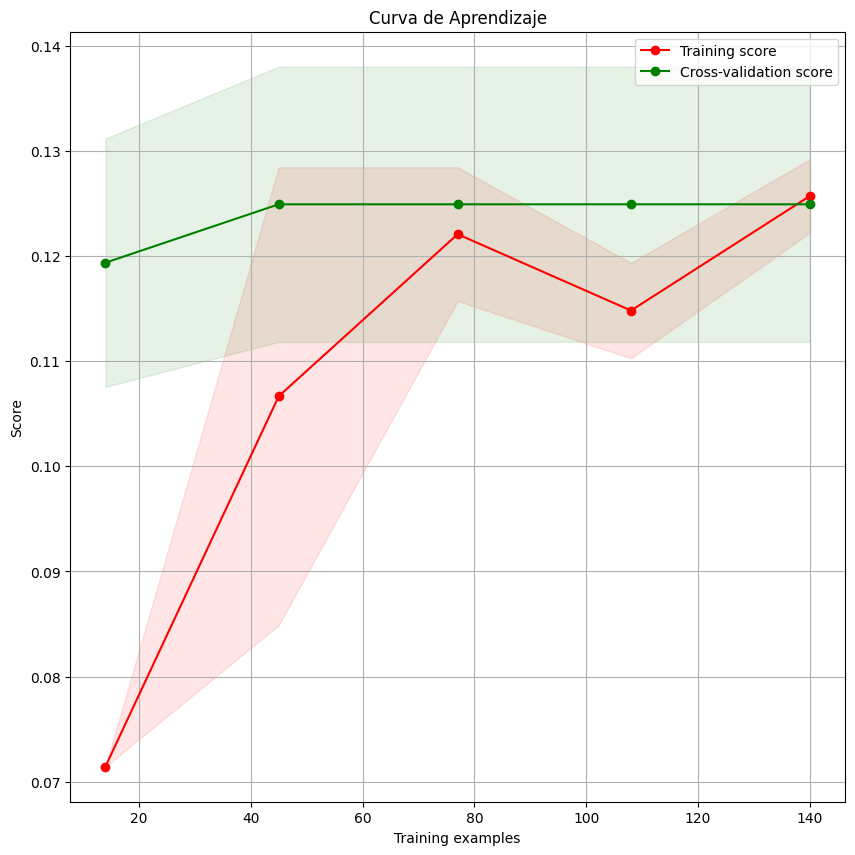

In [ ]:
#Se genera la curva de aprendizaje
plot_learning_curve(estimator=mlp_2,
                    X=X_train,
                    y=y_train,
                    title='Curva de Aprendizaje')
plt.show()

# Análisis

En la curva de aprendizaje se pueden detallar dos líneas, la línea roja representa el puntaje de entrenamiento y la línea verde representa el puntaje de validación cruzada a medida que se incrementa el número de ejemplos de entrenamiento.

En la gráfica se puede observar que al inicio, con pocos ejemplos de entrenamiento, el puntaje de entrenamiento es bajo.
El puntaje de validación cruzada es mayor, lo que indica que el modelo tiene mejor respuesta a los datos de test.

Por otro lado, a medida que se aumentan los ejemplos de entrenamiento, el puntaje de entrenamiento aumenta.

El puntaje de validación cruzada muestra una ligera tendencia ascendente, lo cual es una señal positiva debido a que indica una mejora en la capacidad de generalización del modelo.

**Tercera Arquitectura**
--------------

In [ ]:
#Four hidden layer each layer with ELEGIR LAS NEURONASSSSS
mlp = MLPClassifier((36,36,36, 36), #Tamaño de la red
                      max_iter=1000, #Número de iteraciones
                      activation='relu', # Función de activación
                      solver='sgd', # optimizador de función de perdida
                      learning_rate='adaptive', # Cambios en la tasa de aprendizaje
                      random_state=1,
                      early_stopping=True) #Evitar sobre entrenamiento en la convergencia del optimizador
print(mlp)

MLPClassifier(early_stopping=True, hidden_layer_sizes=(36, 36, 36, 36),
              learning_rate='adaptive', max_iter=1000, random_state=1,
              solver='sgd')


In [ ]:
mlp.fit(X_train,y_train)

predict_train2 = mlp.predict(X_train)
print(predict_train2)
predict_test2 = mlp.predict(X_test)
print(predict_test2)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


In [ ]:
#%% Results, esta matriz debe de dar enormeeeeee
print(confusion_matrix(y_train,predict_train))

[[ 0  0  0  0  0 26  0]
 [ 0  0  0  0  0 25  0]
 [ 0  0  0  0  0 22  0]
 [ 0  0  0  0  0 29  0]
 [ 0  0  0  0  0 26  0]
 [ 0  0  0  0  0 22  0]
 [ 0  0  1  0  0 25  0]]


In [ ]:
# Importar las funciones necesarias
from sklearn.metrics import classification_report

# Especificar las etiquetas de las clases directamente
labels = ['0','1', '2', '3', '4','5','6']

# Imprimir el reporte de clasificación
print(classification_report(y_train, predict_train2, labels=labels))

              precision    recall  f1-score   support

           0       0.15      1.00      0.26        26
           1       0.00      0.00      0.00        25
           2       0.00      0.00      0.00        22
           3       0.00      0.00      0.00        29
           4       0.00      0.00      0.00        26
           5       0.00      0.00      0.00        22
           6       0.00      0.00      0.00        26

   micro avg       0.15      0.15      0.15       176
   macro avg       0.02      0.14      0.04       176
weighted avg       0.02      0.15      0.04       176



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
print(confusion_matrix(y_test,predict_test))
print(' ')

print(classification_report(y_test,predict_test2,labels=labels))

[[ 0  0  0  0  0 10  0]
 [ 0  0  0  0  0 11  0]
 [ 0  0  1  0  0 13  0]
 [ 0  0  0  0  0  7  0]
 [ 0  0  0  0  0 10  0]
 [ 0  0  0  0  0 14  0]
 [ 0  0  0  0  0 10  0]]
 
              precision    recall  f1-score   support

           0       0.13      1.00      0.23        10
           1       0.00      0.00      0.00        11
           2       0.00      0.00      0.00        14
           3       0.00      0.00      0.00         7
           4       0.00      0.00      0.00        10
           5       0.00      0.00      0.00        14
           6       0.00      0.00      0.00        10

   micro avg       0.13      0.13      0.13        76
   macro avg       0.02      0.14      0.03        76
weighted avg       0.02      0.13      0.03        76



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Confusion matrix, without normalization
[[ 0  0  0  0  0 26  0]
 [ 0  0  0  0  0 25  0]
 [ 0  0  0  0  0 22  0]
 [ 0  0  0  0  0 29  0]
 [ 0  0  0  0  0 26  0]
 [ 0  0  0  0  0 22  0]
 [ 0  0  1  0  0 25  0]]
Confusion matrix, without normalization
[[ 0  0  0  0  0 10  0]
 [ 0  0  0  0  0 11  0]
 [ 0  0  1  0  0 13  0]
 [ 0  0  0  0  0  7  0]
 [ 0  0  0  0  0 10  0]
 [ 0  0  0  0  0 14  0]
 [ 0  0  0  0  0 10  0]]


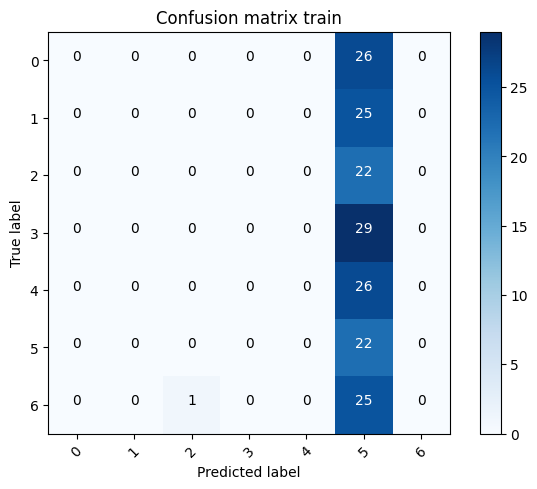

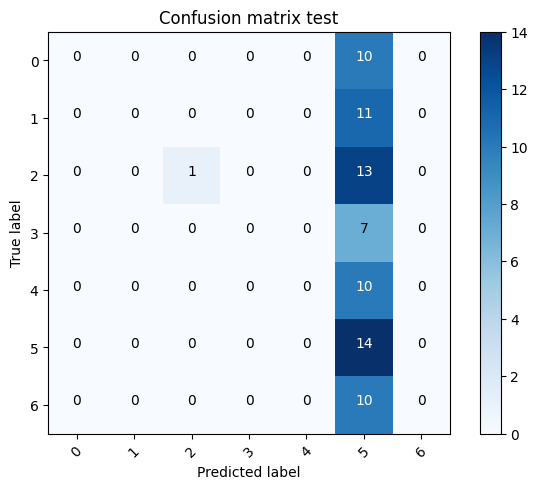

In [ ]:
mc_train = confusion_matrix(y_train,predict_train)
plot_confusion_matrix(mc_train, classes=labels,
                      title='Confusion matrix train')

mc_test = confusion_matrix(y_test,predict_test)
plot_confusion_matrix(mc_test, classes=labels,
                      title='Confusion matrix test')

**Análisis**
----

En la matriz de predicción se puede observar que para varias clase no se tienen datos que sean predichos para dicha clase.

En la segunda clase, se puede observar que el verdadero valor y el valor predicho tienen uno de numeros correctos entre ellos, junto con otro valor real, que fue el 5, el cual, el modelo lo confundió por 2 varias veces.

Para la quinta clase, sólo se hizo una predicción y fue para un valor incorrecto.

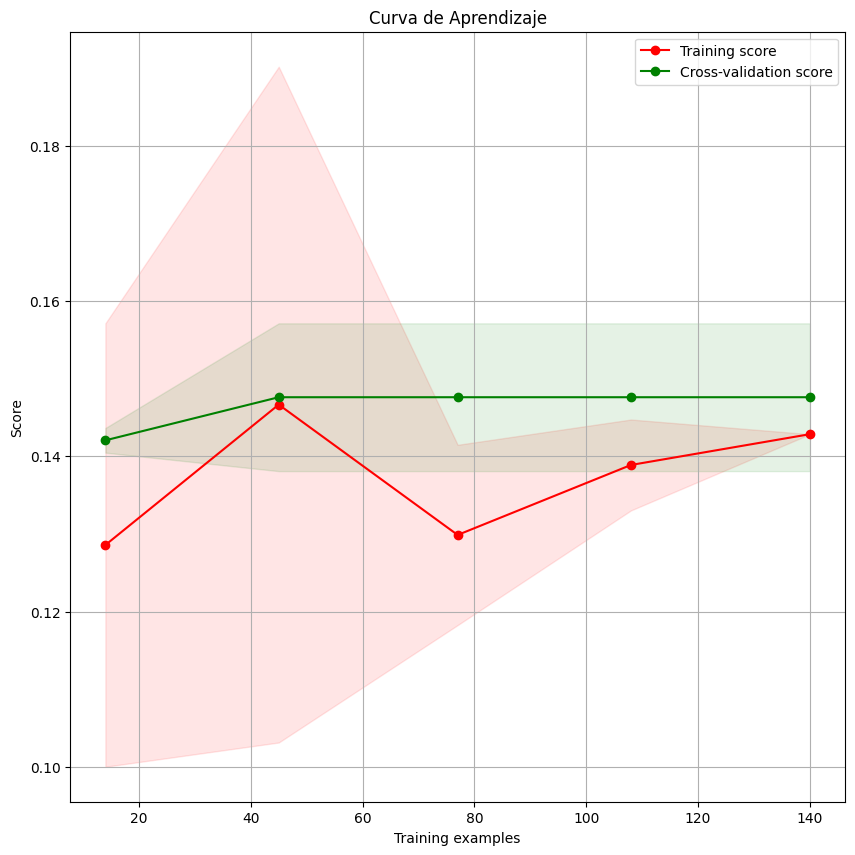

In [ ]:
#Se genera la curva de aprendizaje
plot_learning_curve(estimator=mlp,
                    X=X_train,
                    y=y_train,
                    title='Curva de Aprendizaje')
plt.show()


**Análisis**
-----

En la curva de aprendizaje se pueden detallar dos líneas, la línea roja representa el puntaje de entrenamiento y la línea verde representa el puntaje de validación cruzada a medida que se incrementa el número de ejemplos de entrenamiento.

En la gráfica se puede observar que al inicio, con pocos ejemplos de entrenamiento, el puntaje de entrenamiento y de la validación cruzada son muy cercanos entre ellos. Las curvas se alejan entre ellas a medida que se aumentan los ejemplos de entrenamiento, en donde se tiene que a medida que se aumentan los ejemplos de entrenamiento, el puntaje de entrenamiento disminuye, mientras que los valores de validación cruzada se mantiene estable.

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Ensure y_train and y_test are 1D arrays
y_train = np.ravel(y_train)
y_test = np.ravel(y_test)

model = RandomForestClassifier(random_state=42)
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}
g = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')

# Create a pipeline
steps = [
    ('scaler', StandardScaler()),
    ('clf', g),
]
pip = Pipeline(steps)

# Fit the pipeline to the training data
pip.fit(X_train, y_train)

# Predict on the test data
y_pred = pip.predict(X_test)

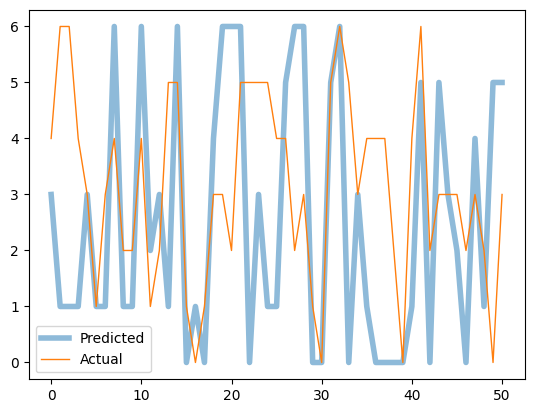

In [ ]:
plt.plot(y_pred, alpha=0.5, linewidth=4, label='Predicted')
plt.plot(y_test, linewidth=1, label='Actual')
plt.legend()
plt.show()

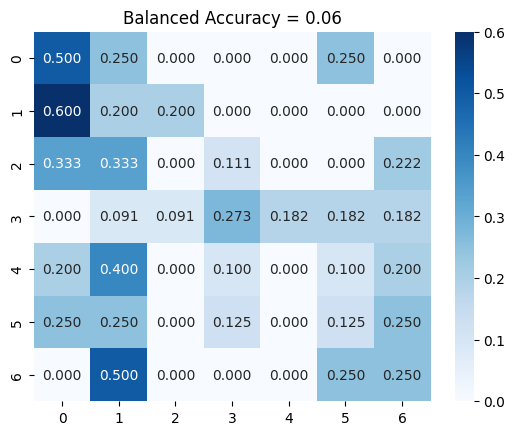

In [ ]:
from sklearn.metrics import confusion_matrix, balanced_accuracy_score
import seaborn as sns

conf = confusion_matrix(y_test, y_pred, normalize='true')
acc = balanced_accuracy_score(y_test, y_pred, adjusted=True)

# Plot confusion matrix
sns.heatmap(conf, annot=True, fmt='0.3f', cmap='Blues')
plt.title(f'Balanced Accuracy = {acc:0.2f}')
plt.show()

**Bibliografia**
---
[1] https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.learning_curve.html